In [1]:
!pip install --upgrade pingouin

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import datetime
import random
import statistics
from math import pi
from matplotlib.gridspec import GridSpec
from dateutil.relativedelta import *
import matplotlib.dates as mdates
from matplotlib.dates import DateFormatter
import seaborn as sns
import scipy.stats
import pingouin as pg

In [77]:
# COMMON VARIABLES

alg_to_analyze = [
    'vader_sentiment_analysis_score',
    'vader_sentiment_analysis_polarity'
]

tpd_columns = ["text", "created_at", "id_user", "vader_sentiment_analysis_score", "vader_sentiment_analysis_polarity",
                         "oplexicon_sentiment_analysis_score", "oplexicon_sentiment_analysis_polarity",
                         "sentistrength_sentiment_analysis_score", "sentistrength_sentiment_analysis_polarity",
                         "sentilexpt_sentiment_analysis_score", "sentilexpt_sentiment_analysis_polarity",
                         "final_score", "final_polarity"]

clean_df_columns = [
    'text',
    'final_score',
    'final_polarity',
    'oplexicon_sentiment_analysis_score',
    'oplexicon_sentiment_analysis_polarity',
    'sentistrength_sentiment_analysis_score',
    'sentistrength_sentiment_analysis_polarity',
    'sentilexpt_sentiment_analysis_score',
    'sentilexpt_sentiment_analysis_polarity'
]

In [3]:
!python3 '/Users/leosilva/development/thesis/workspacePyCharm/TwitterDataMining/main_generate_json_files.py'

Starting script...
Removing existing file...
Ending script...


In [4]:
data = pd.read_json(r'/Users/leosilva/development/thesis/workspacePyCharm/TwitterDataMining/alldata.json')
data.head()

,26,27,28,29,30,31,32,33,34,35,36,37
id_str_twitter,23781146,15148309,927028057763995648,77648005,3429765093,10794662,1034514325644431361,529445600,12050562,62314491,18289937,172880784
name,Fe Rebelatto,Sommelier de Airbnb,✪ Felippe,Conference Distinguished Specialist,Paula Santana,Maharaja of the Legacies,Jessica,"var nickname = ""Riquettinha"";",Roberta Arcoverde,Gabriela,Thamara Andrade,felipe.ts ⚡
screen_name,rebelatto,Guilh_rm_,FelippeRegazio,NannoKa,psanrosa13,rponte,dev_jessi,Riquettinha,rla4,Gabrielathalita,thamyk,felipefialho_
location,"Rio de Janeiro, Brasil",somewhere in Brazil,,Ctba-PR Brasil,Brasil,"Ceará, Brazil",São Paulo - Brasil,"Belo Horizonte, Brasil","Sao Paulo, Brazil",Belo Horizonte,"Belo Horizonte, Brazil.",Dark Side of the Moon
url,None,https://t.co/gX4oRZWHg3,https://t.co/KkaPlVH4Wu,https://t.co/hDni4Fh2Ng,https://t.co/YJQuDtv2YW,https://t.co/3yZ94QNQvs,https://t.co/MtUeSEBICu,https://t.co/QU71LJgSuD,None,https://t.co/AmkOKWlftK,https://t.co/JWBzdmQOcV,https://t.co/yPuEuh1bn9


In [78]:
def clean_df(df):
    for c in clean_df_columns:
        del df[c]

In [5]:
def create_tweets_pd(data, id_user):

    tweets_pd = pd.DataFrame(data[id_user]['tweets'])
    del tweets_pd[0]
    del tweets_pd[1]
    del tweets_pd[4]
    del tweets_pd[5]
    del tweets_pd[6]
    del tweets_pd[18]
    
    tweets_pd.columns = ["text", "created_at", "id_user", "vader_sentiment_analysis_score", "vader_sentiment_analysis_polarity",
                         "oplexicon_sentiment_analysis_score", "oplexicon_sentiment_analysis_polarity",
                         "sentistrength_sentiment_analysis_score", "sentistrength_sentiment_analysis_polarity",
                         "sentilexpt_sentiment_analysis_score", "sentilexpt_sentiment_analysis_polarity",
                         "final_score", "final_polarity"]
 
    return tweets_pd

In [70]:
def create_line_plot(df_result, id_user):
    df_result["created_at"] = pd.to_datetime(df_result["created_at"])
    df_result['date_minus_time'] = df_result["created_at"].apply( lambda df_result : datetime.datetime(year=df_result.year, month=df_result.month, day=df_result.day))
    df_result.set_index(df_result["date_minus_time"],inplace=True)

    new_df = pd.DataFrame(df_result[alg_to_analyze[0]].resample('W').mean())

    new_df['week'] = range(1, len(new_df.index) + 1)

    x = new_df["week"]
    y = new_df[alg_to_analyze[0]]

    tickvalues = range(0, int(len(x)), 2)

    if len(tickvalues) > len(x[1::2]):
        tickvalues = range(0, int(len(x)) - (len(tickvalues) - len(x[1::2])), 2)

    fig = plt.figure(figsize=(16,6))

    plt.xticks(ticks = tickvalues ,labels = x[1::2], rotation = 'vertical')

    plt.title("Tweets VADER polarity per week - Participant {}".format(id_user))
    plt.ylabel("Polarity")
    plt.xlabel("Weeks")

    plt.axhline(y.mean(), color='k', linestyle='dashed', linewidth=1)
    min_ylim, max_ylim = plt.ylim()
    plt.text(y.mean()*0.05, max_ylim*0.12, 'Mean: {:.2f}'.format(y.mean()))

    plt.plot(x,y)

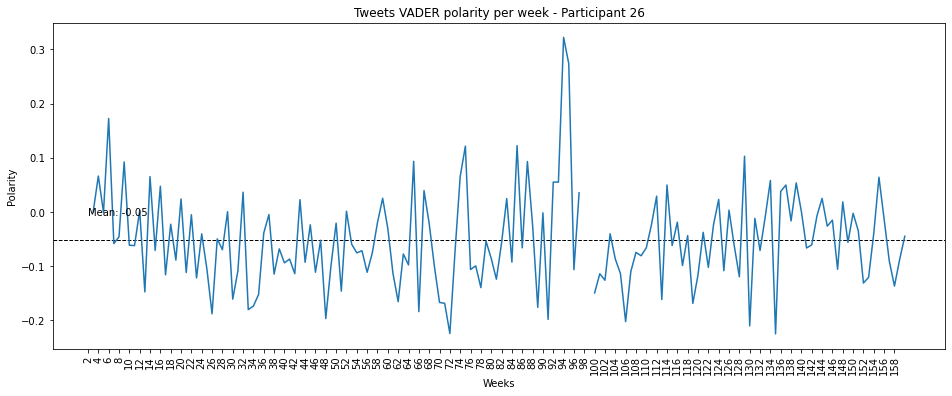

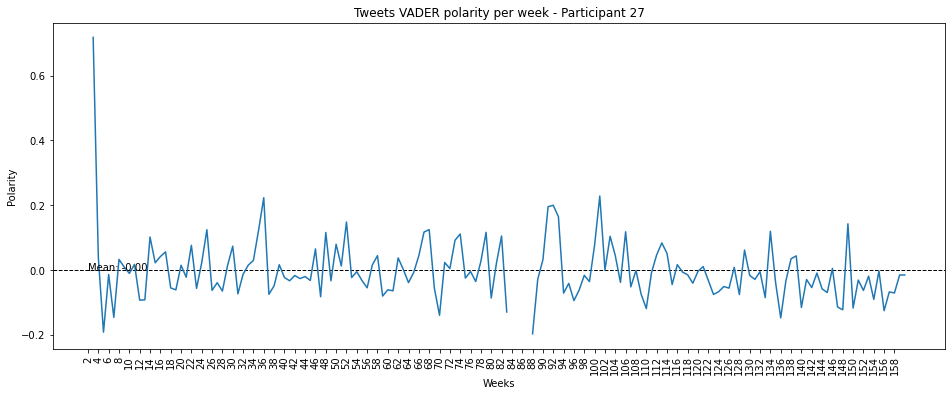

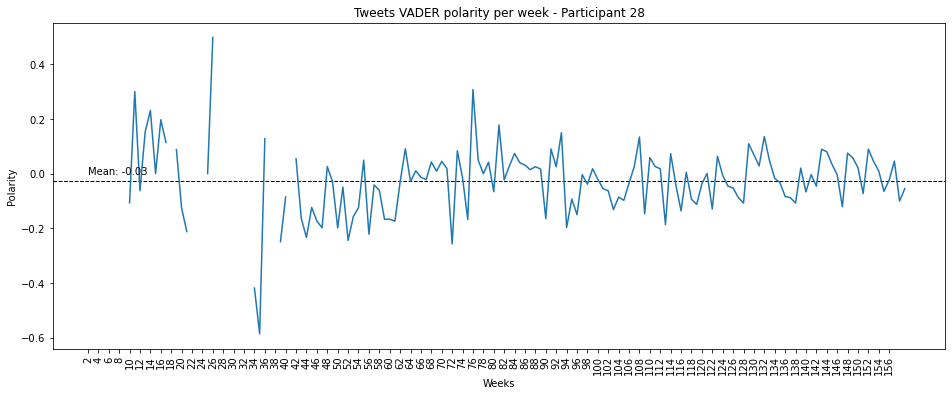

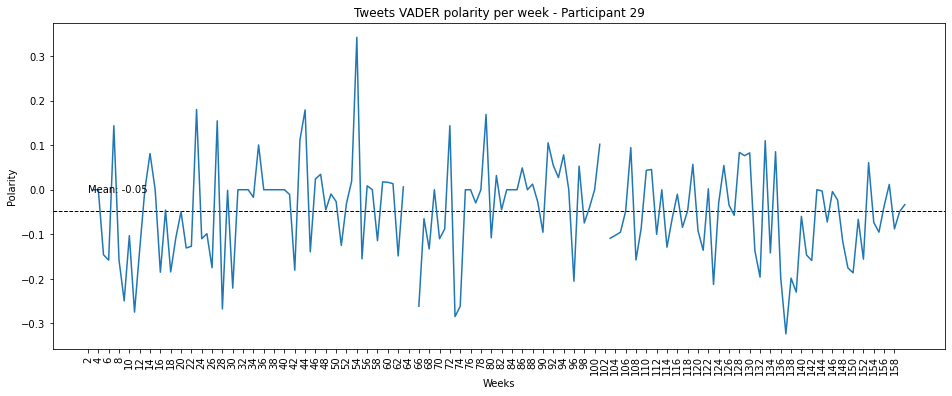

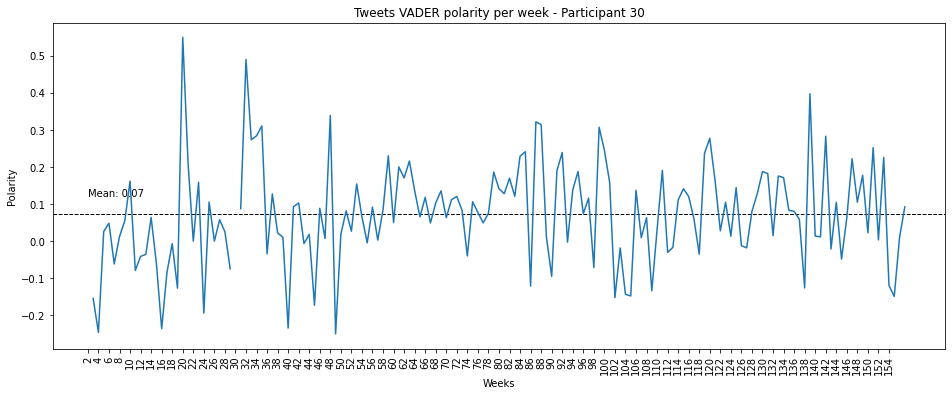

...

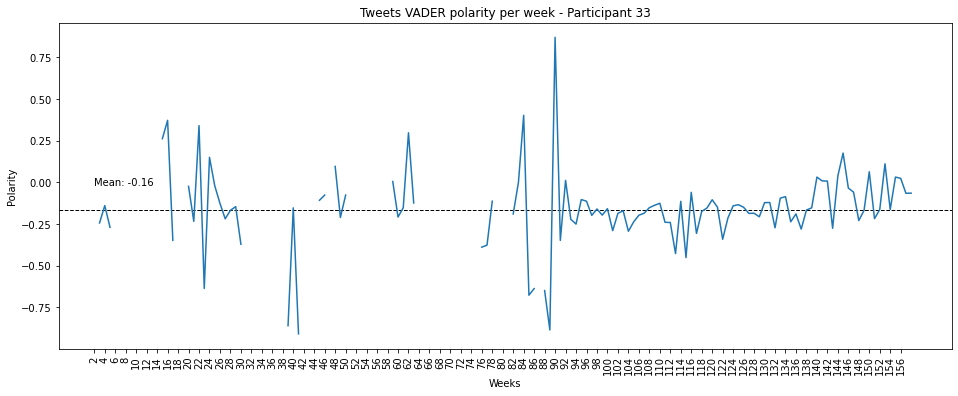

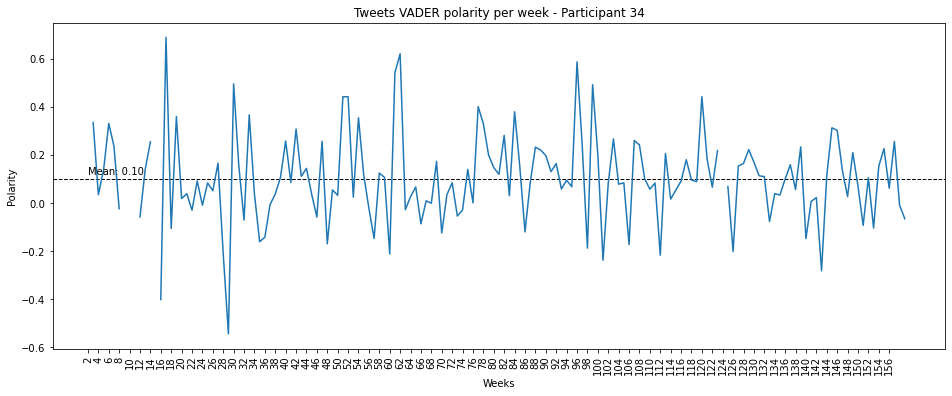

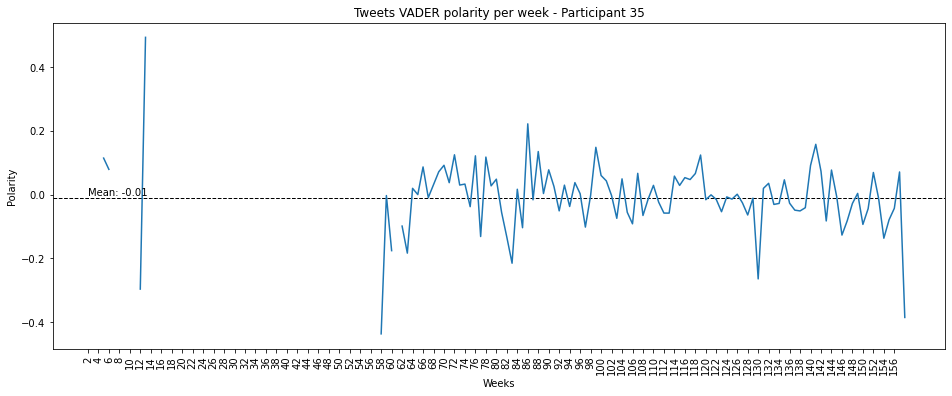

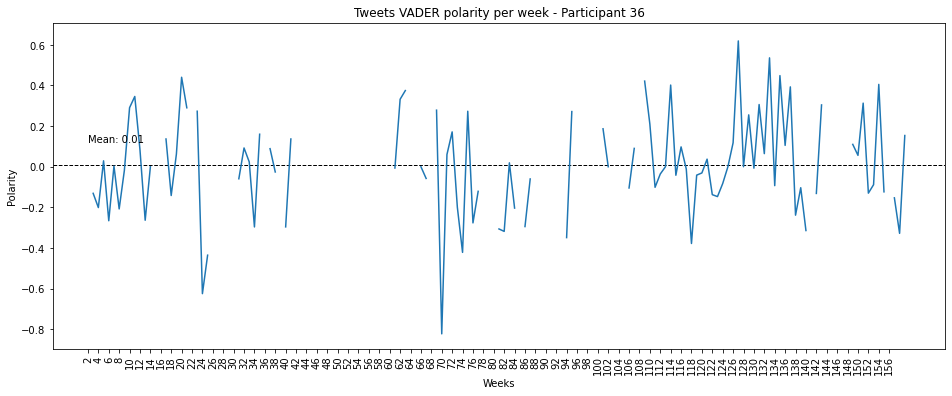

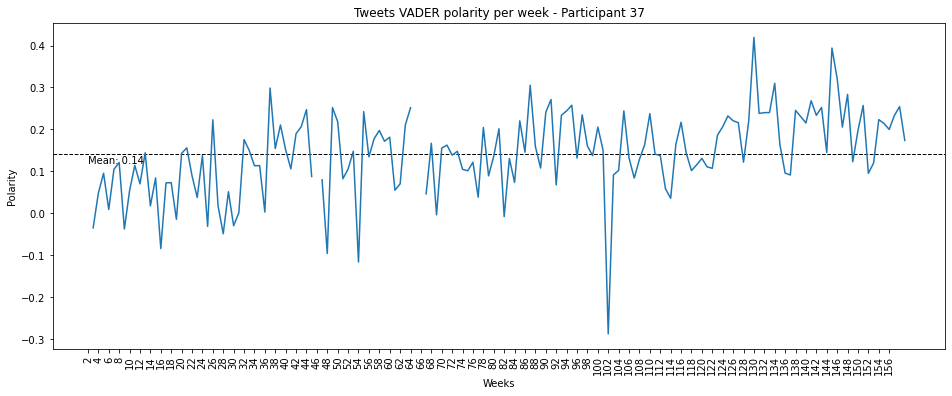

In [71]:
for c in data:
    id_user = c
    tweets_pd = create_tweets_pd(data, id_user)
    
    create_line_plot(tweets_pd, id_user)

In [75]:
# DATA CONSIDERING THE NEUTRAL POLARITY

df_dict = {'id_user' : [],
            'pos' : [],
            'neu' : [],
            'neg' : [],
            'por_pos' : [],
            'por_neu' : [],
            'por_neg' : [],
            'mean' : []
          }

for c in data:
    id_user = c
    print('id_user: {}'.format(id_user))
    print('lexicon: VADER')
    tweets_pd = create_tweets_pd(data, id_user)
    vader_df = tweets_pd[['id_user', alg_to_analyze[0], alg_to_analyze[1]]].copy()
    print('mean: {}'.format(vader_df[alg_to_analyze[0]].mean()))
    qtd_pos = vader_df.query(alg_to_analyze[1] + ' == "pos"')['id_user'].count()
    qtd_neu = vader_df.query(alg_to_analyze[1] + ' == "neu"')['id_user'].count()
    qtd_neg = vader_df.query(alg_to_analyze[1] + ' == "neg"')['id_user'].count()
    qtd_total = vader_df[alg_to_analyze[1]].count()
    print('pos: {}'.format(qtd_pos))
    print('neu: {}'.format(qtd_neu))
    print('neg: {}'.format(qtd_neg))
    print('% pos: {}'.format((qtd_pos / qtd_total) * 100))
    print('% neu: {}'.format((qtd_neu / qtd_total) * 100))
    print('% neg: {}'.format((qtd_neg / qtd_total) * 100))
    print('')
    df_dict['id_user'].append(id_user)
    df_dict['pos'].append(qtd_pos)
    df_dict['neu'].append(qtd_neu)
    df_dict['neg'].append(qtd_neg)
    df_dict['por_pos'].append((qtd_pos / qtd_total) * 100)
    df_dict['por_neu'].append((qtd_neu / qtd_total) * 100)
    df_dict['por_neg'].append((qtd_neg / qtd_total) * 100)
    df_dict['mean'].append(vader_df[alg_to_analyze[0]].mean())

df_chart = pd.DataFrame(df_dict)
df_chart
    

id_user: 26
lexicon: VADER
mean: -0.06212903353840019
pos: 1495
neu: 1423
neg: 2121
% pos: 29.668585036713637
% neu: 28.2397301051796
% neg: 42.09168485810677

id_user: 27
lexicon: VADER
mean: -0.016253154539459354
pos: 1335
neu: 1626
neg: 1588
% pos: 29.347109254781273
% neu: 35.744119586722356
% neg: 34.90877115849637

id_user: 28
lexicon: VADER
mean: -0.025317411090510684
pos: 2217
neu: 1264
neg: 2452
% pos: 37.36726782403506
% neu: 21.304567672341143
% neg: 41.328164503623796

id_user: 29
lexicon: VADER
mean: -0.05576885637503733
pos: 887
neu: 1271
neg: 1191
% pos: 26.48551806509406
% neu: 37.951627351448195
% neg: 35.56285458345775

id_user: 30
lexicon: VADER
mean: 0.06961771752837334
pos: 1246
neu: 948
neg: 978
% pos: 39.281210592686
% neu: 29.88650693568726
% neg: 30.832282471626733

id_user: 31
lexicon: VADER
mean: -0.004537208138759179
pos: 2244
neu: 1442
neg: 2310
% pos: 37.42494996664443
% neu: 24.049366244162776
% neg: 38.5256837891928

id_user: 32
lexicon: VADER
mean: 0.05

,id_user,pos,neu,neg,por_pos,por_neu,por_neg,mean
0,26,1495,1423,2121,29.668585,28.239730,42.091685,-0.062129
1,27,1335,1626,1588,29.347109,35.744120,34.908771,-0.016253
2,28,2217,1264,2452,37.367268,21.304568,41.328165,-0.025317
3,29,887,1271,1191,26.485518,37.951627,35.562855,-0.055769
4,30,1246,948,978,39.281211,29.886507,30.832282,0.069618
5,31,2244,1442,2310,37.424950,24.049366,38.525684,-0.004537
6,32,4005,2002,3167,43.655984,21.822542,34.521474,0.050977
7,33,688,369,1274,29.515230,15.830116,54.654655,-0.151495
8,34,689,397,459,44.595469,25.695793,29.708738,0.090511
9,35,772,1035,788,29.749518,39.884393,30.366089,0.002503


In [74]:
# DATA WITHOUT THE NEUTRAL POLARITY

df_dict = {'id_user' : [],
            'pos' : [],
            'neu' : [],
            'neg' : [],
            'por_pos' : [],
            'por_neu' : [],
            'por_neg' : [],
            'mean_all' : [],
            'mean_posneg' : []
          }

for c in data:
    id_user = c
    print('id_user: {}'.format(id_user))
    print('lexicon: VADER')
    tweets_pd = create_tweets_pd(data, id_user)
    vader_df = tweets_pd[['id_user', alg_to_analyze[0], alg_to_analyze[1]]].copy()
    final_score = vader_df.query(alg_to_analyze[1] + ' == "pos"')[alg_to_analyze[0]].tolist()
    final_score.extend(vader_df.query(alg_to_analyze[1] + ' == "neg"')[alg_to_analyze[0]].tolist())
    print(len(final_score))
    print(statistics.mean(final_score))
    print('mean: {}'.format(vader_df[alg_to_analyze[0]].mean()))
    qtd_pos = vader_df.query(alg_to_analyze[1] + ' == "pos"')['id_user'].count()
    qtd_neu = vader_df.query(alg_to_analyze[1] + ' == "neu"')['id_user'].count()
    qtd_neg = vader_df.query(alg_to_analyze[1] + ' == "neg"')['id_user'].count()
    qtd_total = vader_df[alg_to_analyze[1]].count()
    print('pos: {}'.format(qtd_pos))
    print('neu: {}'.format(qtd_neu))
    print('neg: {}'.format(qtd_neg))
    print('% pos: {}'.format((qtd_pos / qtd_total) * 100))
    print('% neu: {}'.format((qtd_neu / qtd_total) * 100))
    print('% neg: {}'.format((qtd_neg / qtd_total) * 100))
    print('')
    df_dict['id_user'].append(id_user)
    df_dict['pos'].append(qtd_pos)
    df_dict['neu'].append(qtd_neu)
    df_dict['neg'].append(qtd_neg)
    df_dict['por_pos'].append((qtd_pos / qtd_total) * 100)
    df_dict['por_neu'].append((qtd_neu / qtd_total) * 100)
    df_dict['por_neg'].append((qtd_neg / qtd_total) * 100)
    df_dict['mean_all'].append(vader_df[alg_to_analyze[0]].mean())
    df_dict['mean_posneg'].append(statistics.mean(final_score))

df_chart = pd.DataFrame(df_dict)
df_chart
    

id_user: 26
lexicon: VADER
3616
-0.08657859513274337
mean: -0.06212903353840019
pos: 1495
neu: 1423
neg: 2121
% pos: 29.668585036713637
% neu: 28.2397301051796
% neg: 42.09168485810677

id_user: 27
lexicon: VADER
2923
-0.025294423537461513
mean: -0.016253154539459354
pos: 1335
neu: 1626
neg: 1588
% pos: 29.347109254781273
% neu: 35.744119586722356
% neg: 34.90877115849637

id_user: 28
lexicon: VADER
4669
-0.03217138573570358
mean: -0.025317411090510684
pos: 2217
neu: 1264
neg: 2452
% pos: 37.36726782403506
% neu: 21.304567672341143
% neg: 41.328164503623796

id_user: 29
lexicon: VADER
2078
-0.08987964388835419
mean: -0.05576885637503733
pos: 887
neu: 1271
neg: 1191
% pos: 26.48551806509406
% neu: 37.951627351448195
% neg: 35.56285458345775

id_user: 30
lexicon: VADER
2224
0.09929289568345324
mean: 0.06961771752837334
pos: 1246
neu: 948
neg: 978
% pos: 39.281210592686
% neu: 29.88650693568726
% neg: 30.832282471626733

id_user: 31
lexicon: VADER
4554
-0.00597389108476065
mean: -0.004537

,id_user,pos,neu,neg,por_pos,por_neu,por_neg,mean_all,mean_posneg
0,26,1495,1423,2121,29.668585,28.239730,42.091685,-0.062129,-0.086579
1,27,1335,1626,1588,29.347109,35.744120,34.908771,-0.016253,-0.025294
2,28,2217,1264,2452,37.367268,21.304568,41.328165,-0.025317,-0.032171
3,29,887,1271,1191,26.485518,37.951627,35.562855,-0.055769,-0.089880
4,30,1246,948,978,39.281211,29.886507,30.832282,0.069618,0.099293
5,31,2244,1442,2310,37.424950,24.049366,38.525684,-0.004537,-0.005974
6,32,4005,2002,3167,43.655984,21.822542,34.521474,0.050977,0.065206
7,33,688,369,1274,29.515230,15.830116,54.654655,-0.151495,-0.179987
8,34,689,397,459,44.595469,25.695793,29.708738,0.090511,0.121811
9,35,772,1035,788,29.749518,39.884393,30.366089,0.002503,0.004163


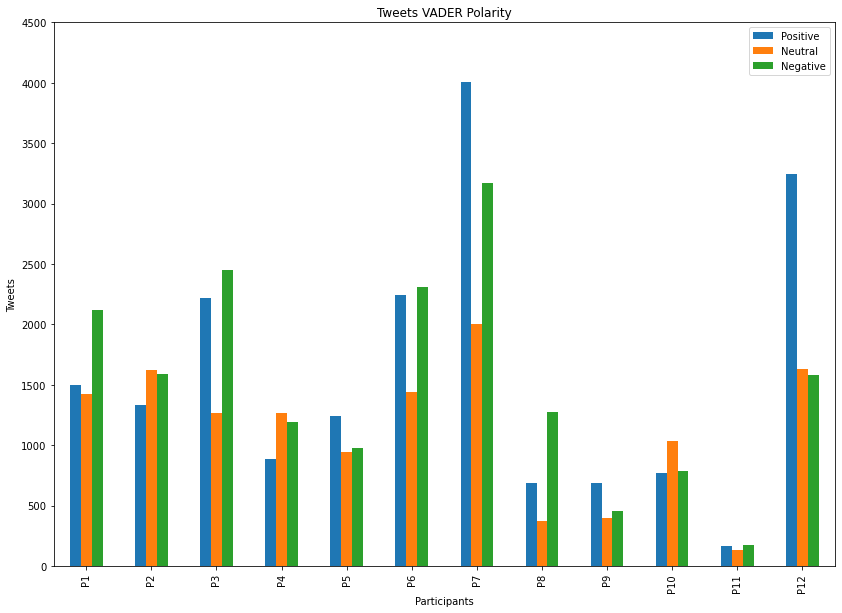

In [13]:
# multiple bar plots

bar_chart_data = []

y_range = range(0,4501, 500)

for i in df_chart.index:
    d = ['P{}'.format(i+1), df_chart.iloc[i]['pos'], df_chart.iloc[i]['neu'], df_chart.iloc[i]['neg']]
    bar_chart_data.append(d)

df = pd.DataFrame(bar_chart_data, columns=["Participant","pos","neu","neg"])
df.plot(yticks = y_range, x="Participant", y=["pos", "neu", "neg"], kind="bar",figsize=(14,10))

plt.legend(["Positive", "Neutral", "Negative"])
plt.title('Tweets VADER Polarity')
plt.xlabel('Participants')
plt.ylabel('Tweets')

plt.show()

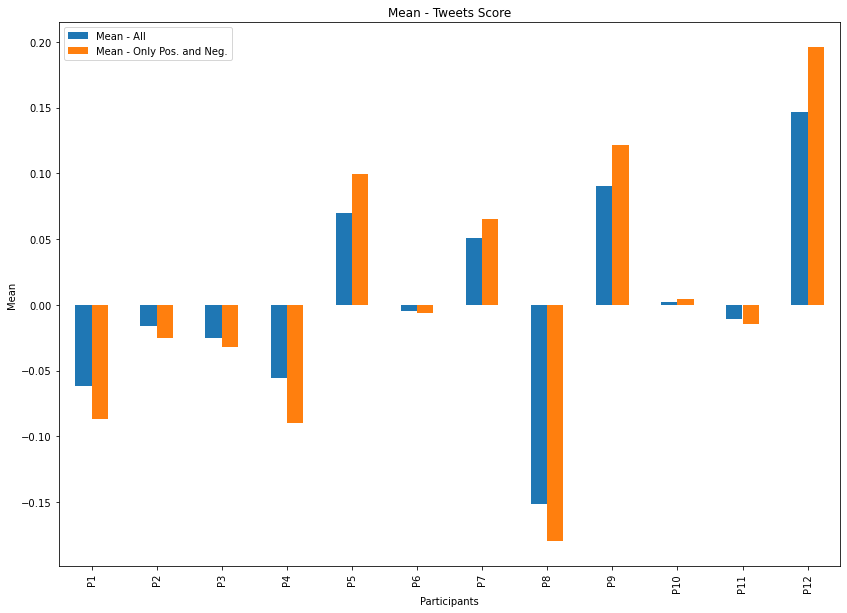

In [14]:
# multiple bar plots with means

bar_chart_data = []

y_range = range(-1,1)

for i in df_chart.index:
    d = ['P{}'.format(i+1), df_chart.iloc[i]['mean_all'], df_chart.iloc[i]['mean_posneg']]
    bar_chart_data.append(d)

df = pd.DataFrame(bar_chart_data, columns=["Participant","mean_all","mean_posneg"])
df.plot(x="Participant", y=["mean_all", "mean_posneg"], kind="bar",figsize=(14,10))

plt.legend(["Mean - All", "Mean - Only Pos. and Neg."])
plt.title('Mean - Tweets Score')
plt.xlabel('Participants')
plt.ylabel('Mean')

plt.show()

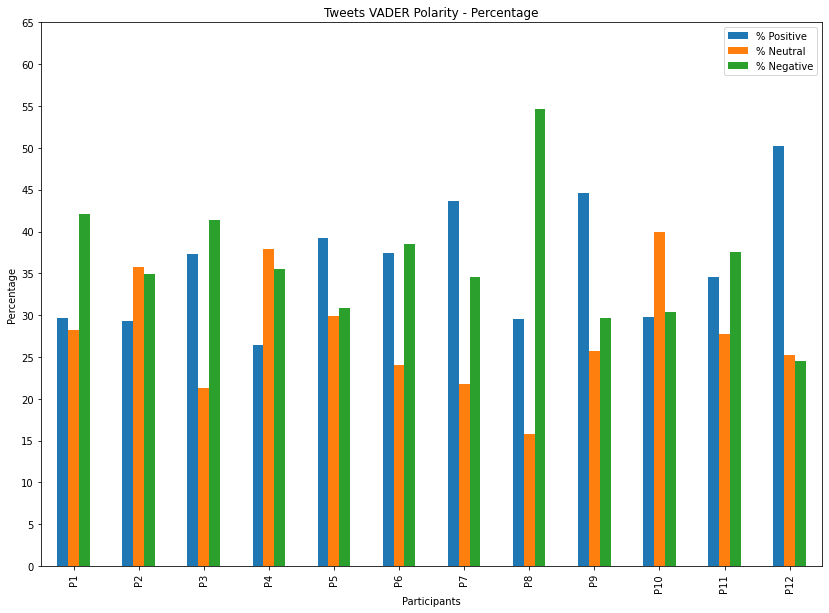

In [15]:
# multiple line plots

bar_chart_data = []

y_range = range(0, 70, 5)

for i in df_chart.index:
    d = ['P{}'.format(i+1), df_chart.iloc[i]['por_pos'], df_chart.iloc[i]['por_neu'], df_chart.iloc[i]['por_neg']]
    bar_chart_data.append(d)

df = pd.DataFrame(bar_chart_data, columns=["Participant","por_pos","por_neu","por_neg"])
df.plot(yticks = y_range, x="Participant", y=["por_pos", "por_neu", "por_neg"], kind="bar",figsize=(14,10))


plt.legend(['% Positive', '% Neutral', '% Negative'])
plt.title('Tweets VADER Polarity - Percentage')
plt.xlabel('Participants')
plt.ylabel('Percentage')

plt.show()

In [16]:
bigfive = {}

for c in data:
    id_user = c

    df_bf = pd.DataFrame(data[id_user]['bigfive'])
    
    if df_bf.empty == False:
        id = int(df_bf[6])

        del df_bf[0]
        del df_bf[6]

        df_bf.columns = ['O', 'C', 'E', 'A', 'N']

        bigfive[id] = df_bf

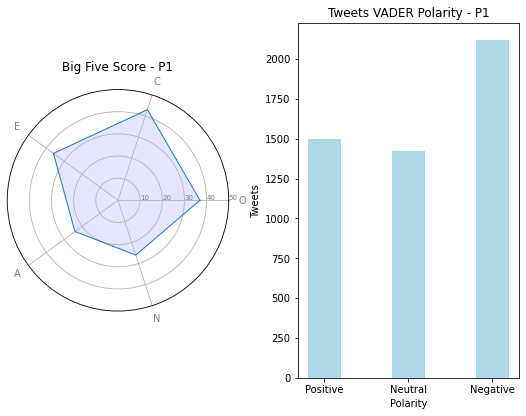

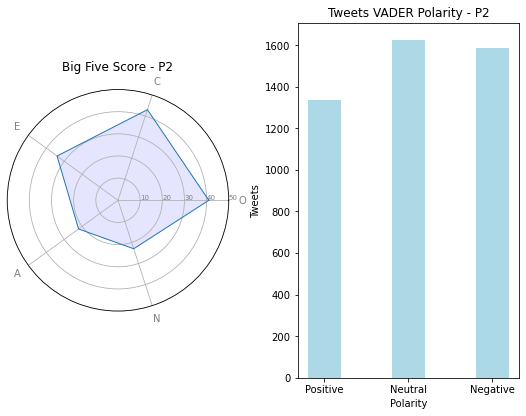

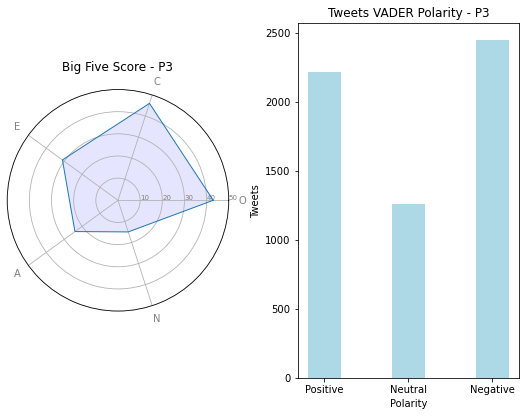

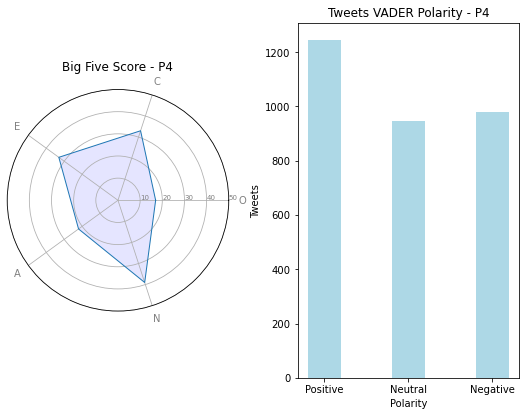

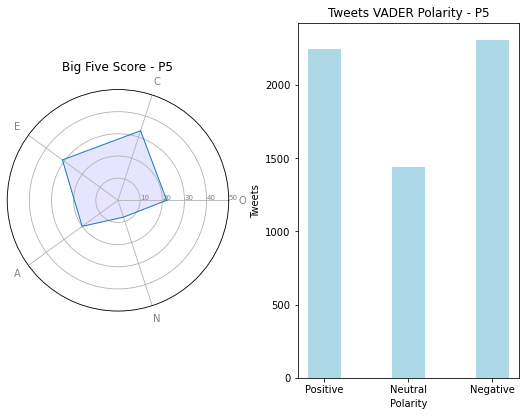

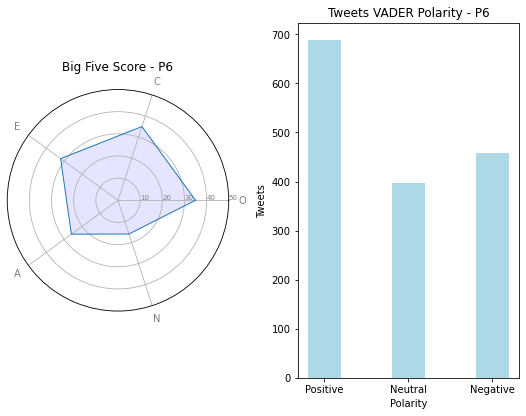

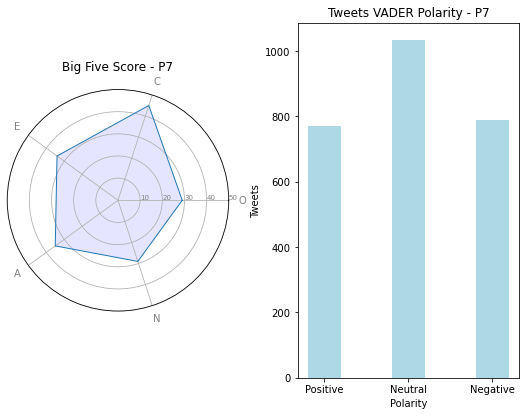

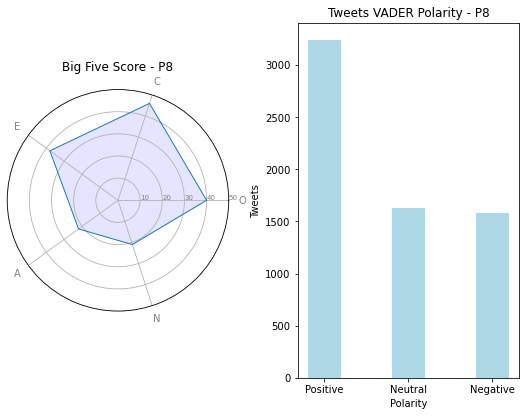

In [17]:
count = 1

for i in bigfive:
    b = bigfive[i]

    o = [b['O']]
    c = [b['C']]
    e = [b['E']]
    a = [b['A']]
    n = [b['N']]

    # Set data
    df = pd.DataFrame({
    'group': ['A'],
    'O': o,
    'C': c,
    'E': e,
    'A': a,
    'N': n
    })

    # number of variable
    categories=list(df)[1:]
    N = len(categories)

    # We are going to plot the first line of the data frame.
    # But we need to repeat the first value to close the circular graph:
    values=df.loc[0].drop('group').values.flatten().tolist()
    values += values[:1]
    values

    # What will be the angle of each axis in the plot? (we divide the plot / number of variable)
    angles = [n / float(N) * 2 * pi for n in range(N)]
    angles += angles[:1]

    
    fig = plt.figure(figsize=(8, 6))
    gs = GridSpec(nrows=1, ncols=2)
    
    # Initialise the spider plot
    ax = fig.add_subplot(gs[0, 0])
    ax = plt.subplot(121, polar=True)

    # Draw one axe per variable + add labels
    plt.xticks(angles[:-1], categories, color='grey', size=10)

    # Draw ylabels
    ax.set_rlabel_position(0)
    plt.yticks([10,20,30, 40, 50], ["10","20","30", '40', '50'], color="grey", size=7)
    plt.ylim(0,50)

    # Plot data
    ax.plot(angles, values, linewidth=1, linestyle='solid')

    # Fill area
    ax.fill(angles, values, 'b', alpha=0.1)
    
    plt.title('Big Five Score - P{}'.format(count))
    
#     plt.tight_layout()

    # Show the graph
#     plt.show()
    
    plt.subplot(122)
    
    y_range = range(0,6001, 500)

    d = {"Positive": int(df_chart.query('id_user == {}'.format(i))['pos']), 
         "Neutral": int(df_chart.query('id_user == {}'.format(i))['neu']), 
         "Negative": int(df_chart.query('id_user == {}'.format(i))['neg'])}
    
#     plt.figure(figsize = (8, 6))

    plt.tight_layout(pad=2.8)
#     plt.subplot_tool()
 
    # creating the bar plot
    plt.bar(d.keys(), d.values(), width = 0.4, color = 'lightblue')

    plt.title('Tweets VADER Polarity - P{}'.format(count))
    plt.xlabel('Polarity')
    plt.ylabel('Tweets')

    plt.show()
    
    count += 1

In [18]:
df_chart

,id_user,pos,neu,neg,por_pos,por_neu,por_neg,mean_all,mean_posneg
0,26,1495,1423,2121,29.668585,28.239730,42.091685,-0.062129,-0.086579
1,27,1335,1626,1588,29.347109,35.744120,34.908771,-0.016253,-0.025294
2,28,2217,1264,2452,37.367268,21.304568,41.328165,-0.025317,-0.032171
3,29,887,1271,1191,26.485518,37.951627,35.562855,-0.055769,-0.089880
4,30,1246,948,978,39.281211,29.886507,30.832282,0.069618,0.099293
5,31,2244,1442,2310,37.424950,24.049366,38.525684,-0.004537,-0.005974
6,32,4005,2002,3167,43.655984,21.822542,34.521474,0.050977,0.065206
7,33,688,369,1274,29.515230,15.830116,54.654655,-0.151495,-0.179987
8,34,689,397,459,44.595469,25.695793,29.708738,0.090511,0.121811
9,35,772,1035,788,29.749518,39.884393,30.366089,0.002503,0.004163


[Text(1, 0, 'Positive'), Text(2, 0, 'Negative'), Text(3, 0, 'Neutral')]

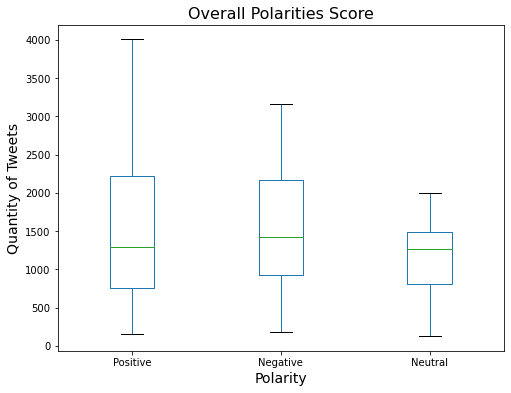

In [19]:
bplot = df_chart.boxplot(column=['pos', 'neg', 'neu'], grid=False, figsize=(8,6))

bplot.axes.set_title("Overall Polarities Score", fontsize=16)
 
bplot.set_xlabel("Polarity", fontsize=14) 
bplot.set_ylabel("Quantity of Tweets", fontsize=14)
bplot.tick_params(labelsize=10)
bplot.set_xticklabels(['Positive', 'Negative', 'Neutral'])

[Text(1, 0, 'Positive (%)'),
 Text(2, 0, 'Negative (%)'),
 Text(3, 0, 'Neutral (%)')]

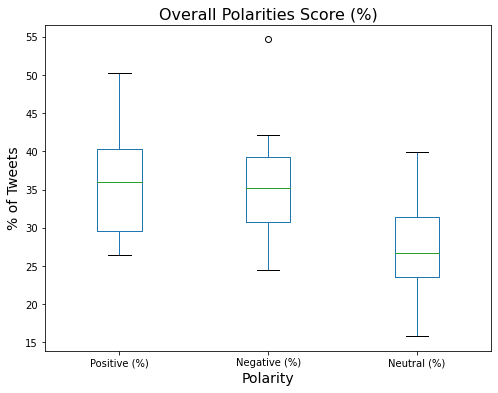

In [20]:
bplot = df_chart.boxplot(column=['por_pos', 'por_neg', 'por_neu'], grid=False, figsize=(8,6))

bplot.axes.set_title("Overall Polarities Score (%)", fontsize=16)
 
bplot.set_xlabel("Polarity", fontsize=14) 
bplot.set_ylabel("% of Tweets", fontsize=14)
bplot.tick_params(labelsize=10)
bplot.set_xticklabels(['Positive (%)', 'Negative (%)', 'Neutral (%)'])

[Text(1, 0, 'All Polarities'), Text(2, 0, 'Only Positives and Negatives')]

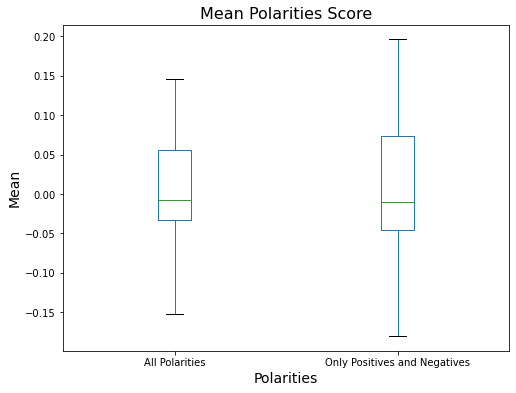

In [21]:
bplot = df_chart.boxplot(column=['mean_all', 'mean_posneg'], grid=False, figsize=(8,6))

bplot.axes.set_title("Mean Polarities Score", fontsize=16)
 
bplot.set_xlabel("Polarities", fontsize=14) 
bplot.set_ylabel("Mean", fontsize=14)
bplot.tick_params(labelsize=10)
bplot.set_xticklabels(['All Polarities', 'Only Positives and Negatives'])

In [76]:
def plot_point_chart(df, count, id_user):

    first_date = df.iloc[0]['date_minus_time']
    
    for i in range(1,13):
        end_date = first_date + relativedelta(months=+3)
        mask = (df['created_at'] >= first_date) & (df['created_at'] < end_date)
        new_df = df.loc[mask]
        
        fig, ax = plt.subplots(figsize=(24, 8))
    
        x = new_df['date_minus_time']
        y = new_df[alg_to_analyze[0]]

        x_ticks = x

        colors = {'pos':'green', 'neu':'orange', 'neg':'red'}

        plt.yticks(np.arange(-1.0, 1.1, 0.1), fontsize=16)
        plt.xticks(x_ticks, rotation='vertical', fontsize=16)

        date_form = DateFormatter("%Y-%m-%d")
        ax.xaxis.set_major_formatter(date_form)
        plt.xlabel('Day', fontsize=16)
        plt.ylabel('Polarity VADER Score', fontsize=16)
        
        plt.title('Scatter Plot - VADER - P{}, User {} - From {} To {}'.format(count, id_user, first_date.strftime("%Y-%m-%d"), end_date.strftime("%Y-%m-%d")), fontsize=20)
        
        plt.rcParams.update({
            "savefig.facecolor": (1.0, 1.0, 1.0)
        })
        
        plt.legend()

        plt.scatter(x, y, alpha=0.7, c=new_df[alg_to_analyze[1]].map(colors))
        
#         plt.savefig('images/scatter_P{}_U{}_{}_{}.pdf'.format(count, id_user, first_date.strftime("%Y-%m-%d"), end_date.strftime("%Y-%m-%d")),bbox_inches='tight',transparent=False)
        
        first_date = end_date

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
/Users/leosilva/opt/anaconda3/lib/python3.7/site-packages/ip

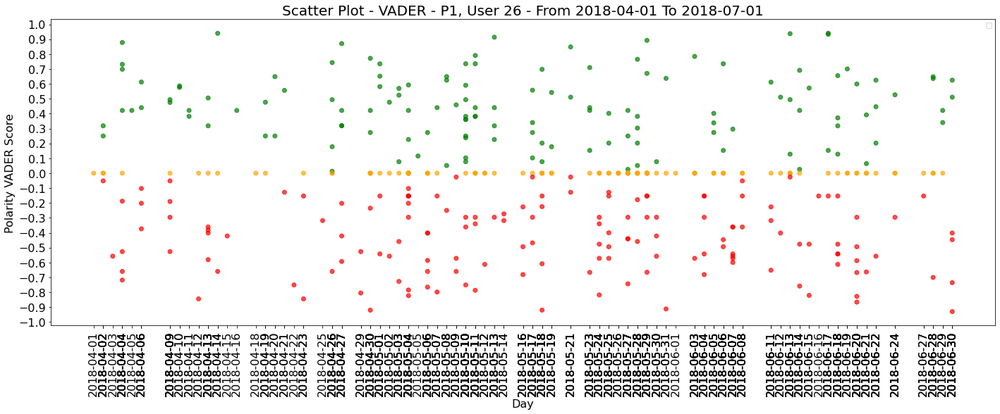

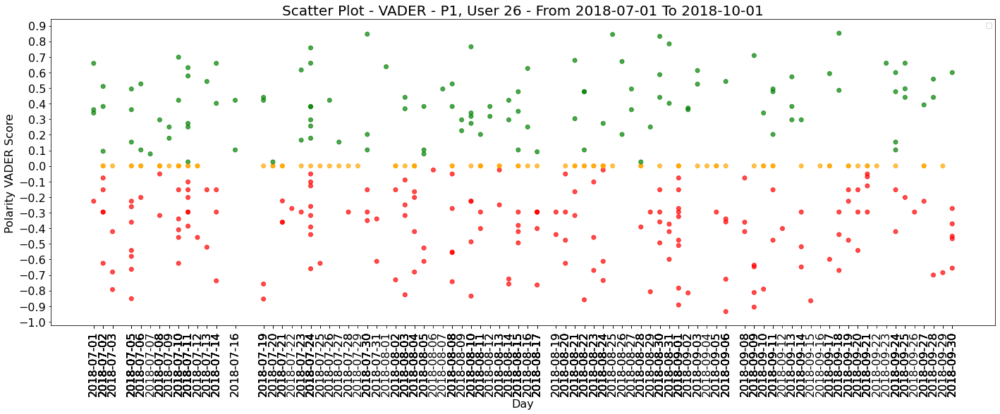

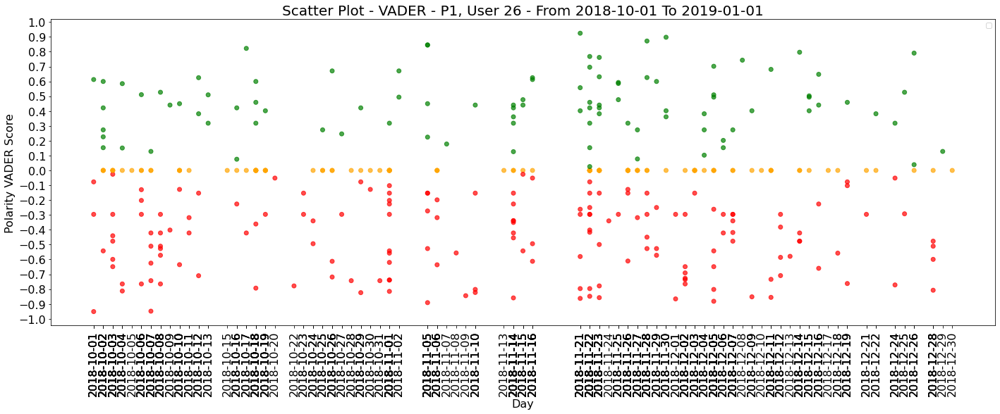

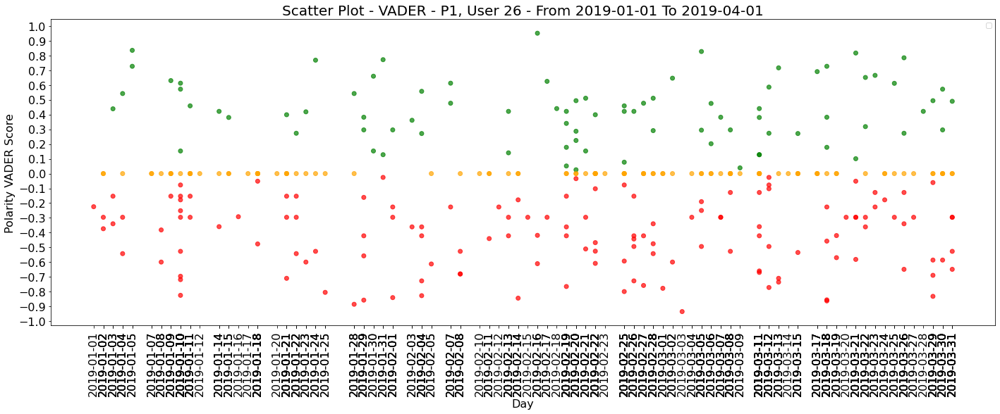

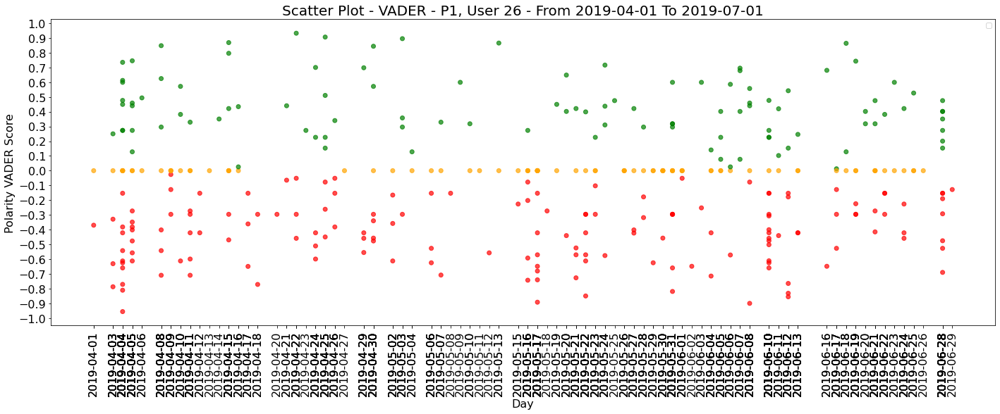

...

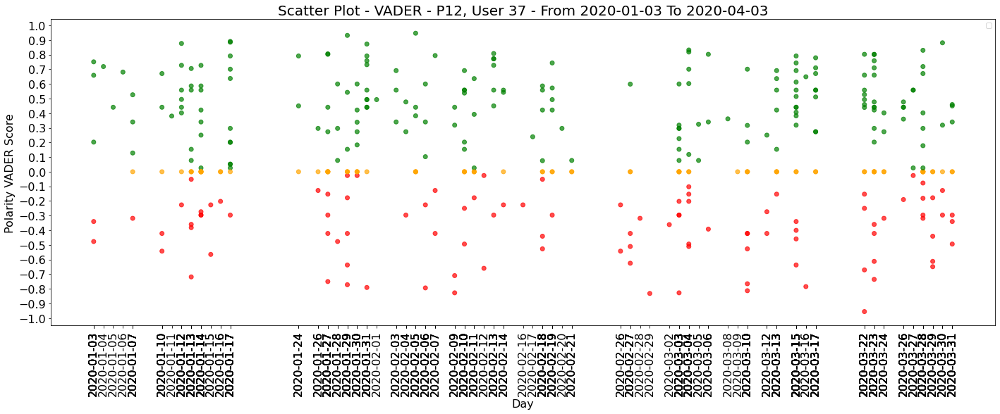

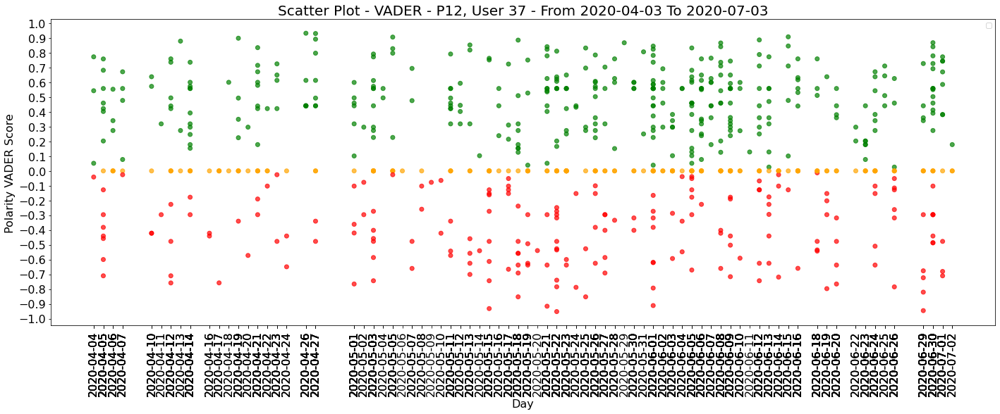

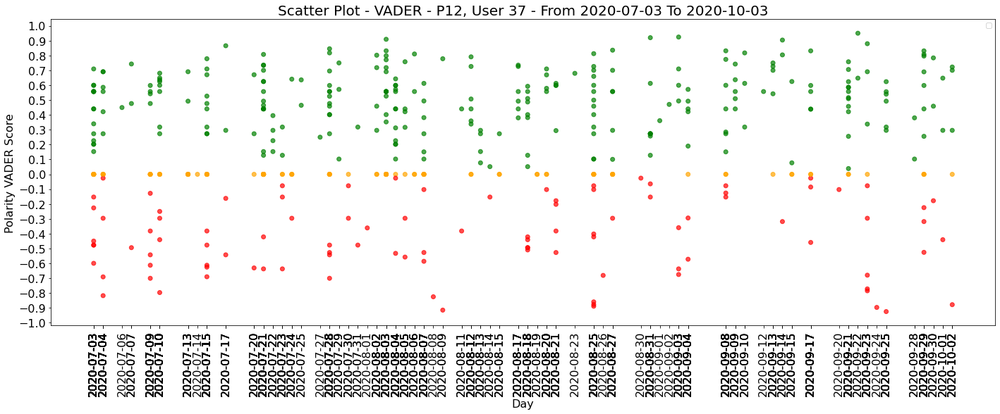

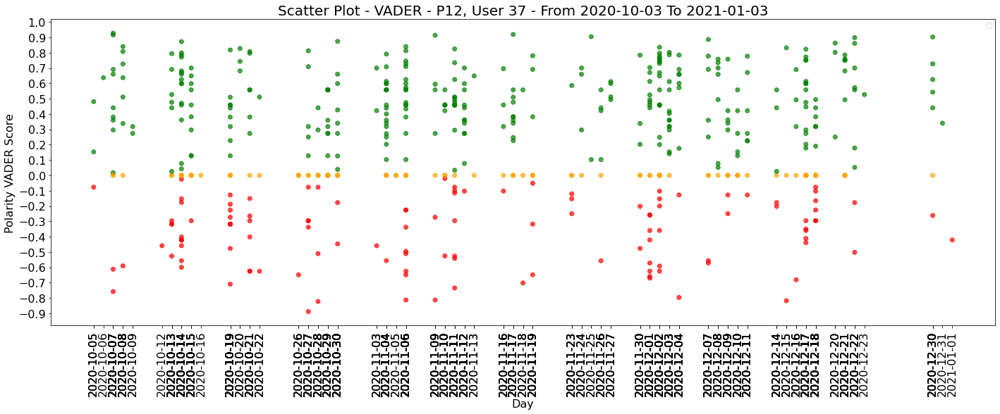

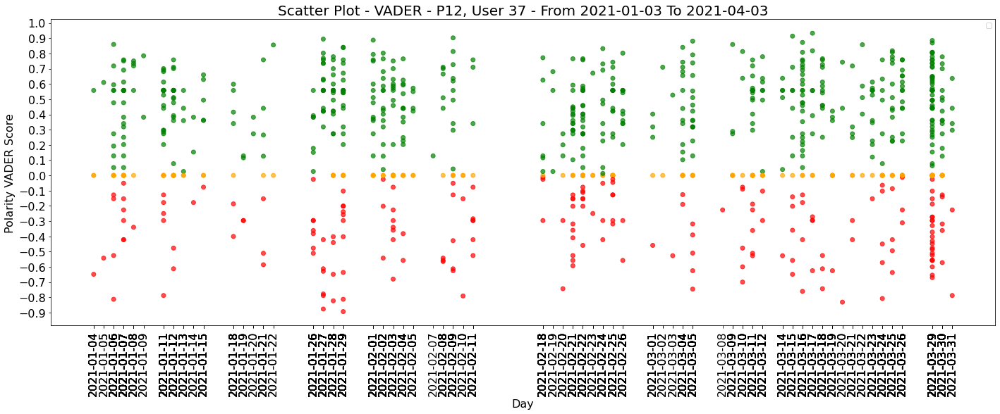

In [23]:
count = 1
for c in data:
    id_user = c
    tweets_pd = create_tweets_pd(data, id_user)
    df = pd.DataFrame(tweets_pd)
    clean_df(df)
    
    df = df.sort_values(by='created_at')
    
    df["created_at"] = pd.to_datetime(df["created_at"])
    df['date_minus_time'] = df["created_at"].apply( lambda df : datetime.datetime(year=df.year, month=df.month, day=df.day))
#     df.set_index(df["date_minus_time"],inplace=True)
    
    plot_point_chart(df, count, id_user)
    
    count += 1

In [25]:
tweets_pd = create_tweets_pd(data, id_user)
df = pd.DataFrame(tweets_pd)
df.head()

,text,created_at,id_user,vader_sentiment_analysis_score,vader_sentiment_analysis_polarity,oplexicon_sentiment_analysis_score,oplexicon_sentiment_analysis_polarity,sentistrength_sentiment_analysis_score,sentistrength_sentiment_analysis_polarity,sentilexpt_sentiment_analysis_score,sentilexpt_sentiment_analysis_polarity,final_score,final_polarity
0,@haggen É um dos grandes mistérios da tecnologia,2021-03-31T18:48:36,37,0.2960,pos,0.00,neu,0.00,neu,0.000,neu,0.074000,pos
1,@fazdenise inclusive quem não trampa lá hahaha,2021-03-31T18:47:57,37,0.3400,pos,0.00,neu,0.00,neu,-0.250,neg,0.022500,pos
2,@DouglasAmarelo Sim! O Spotify consegue fazer ...,2021-03-31T18:47:31,37,0.6360,pos,0.25,pos,0.00,neu,0.250,pos,0.284000,pos
3,StackOverflow ficou fora do ar e fiquei me per...,2021-03-31T16:17:26,37,-0.2263,neg,0.00,neu,-0.25,neg,-0.250,neg,-0.181575,neg
4,@Willian_justen @ludevsz e nada melhor pra est...,2021-03-31T12:23:38,37,0.4404,pos,0.35,pos,0.35,pos,0.225,pos,0.341350,pos


In [31]:
def plot_point_chart_pos_neg(df, count, id_user):

    first_date = df.index[0]
    
    for i in range(1,13):
        
        fig, ax = plt.subplots(figsize=(24, 8))

        end_date = first_date + relativedelta(months=+3)
        mask = (df.index >= first_date) & (df.index < end_date)
        new_df = df.loc[mask]
        
        x_ticks = new_df.index

        plt.xticks(x_ticks, rotation='vertical', fontsize=16)
        plt.yticks(np.arange(-1.0, 1.1, 0.1), fontsize=16)
        plt.xlabel('Day', fontsize=16)
        plt.ylabel('Polarity Score Mean', fontsize=16)

        date_form = DateFormatter("%Y-%m-%d")
        ax.xaxis.set_major_formatter(date_form)
    
        x = new_df.index
        y1 = new_df['vader_score_pos']
        y2 = new_df['vader_score_neg']
        y3 = new_df['mean']

        plt.title('Scatter Plot - Polarity Means - VADER - P{}, User {} - From {} To {}'.format(count, id_user, first_date.strftime("%Y-%m-%d"), end_date.strftime("%Y-%m-%d")), fontsize=20)
        
        plt.rcParams.update({
            "savefig.facecolor": (1.0, 1.0, 1.0)
        })
        
        plt.axhline(y=0.0, color='orange', linestyle='-', alpha=0.7, linewidth=4)
        
#         # plotting the line 1 points 
#         plt.scatter(new_df.index, new_df['final_score_pos'], label = "pos", marker='o', color = 'green')

#         # plotting the line 2 points 
#         plt.scatter(new_df.index, new_df['final_score_neg'], label = "neg", marker='o', color = 'red')
        
        
        # plotting the line 1 points 
        plt.plot(new_df.index, new_df['vader_score_pos'], label = "pos", marker='o', markerfacecolor='none', color = 'green')

        # plotting the line 2 points 
        plt.plot(new_df.index, new_df['vader_score_neg'], label = "neg", marker='o', markerfacecolor='none', color = 'red')
        
        # plotting the line 3 points 
        plt.plot(new_df.index, new_df['mean'], label = "mean", marker='o', markerfacecolor='none', color = 'gray', linestyle='--')
        
        plt.legend()
        
#         plt.savefig('images/scatter_pol_means_P{}_U{}_{}_{}.pdf'.format(count, id_user, first_date.strftime("%Y-%m-%d"), end_date.strftime("%Y-%m-%d")),bbox_inches='tight',transparent=False)
        
        plt.show()
        
        first_date = end_date

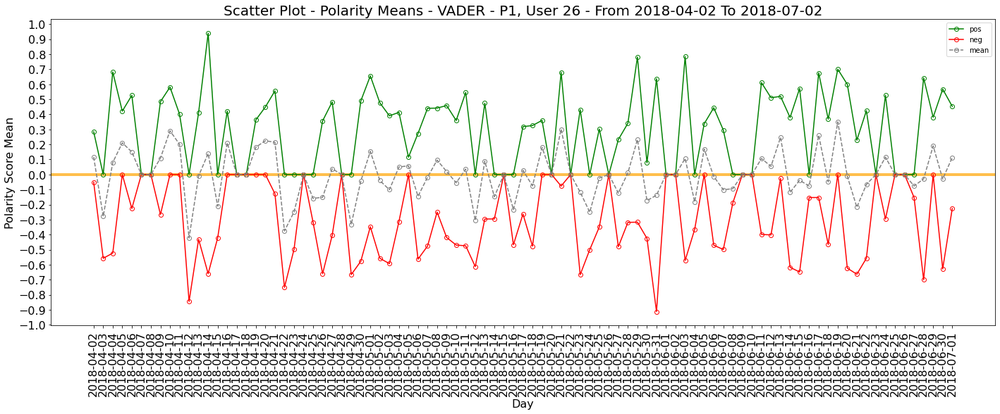

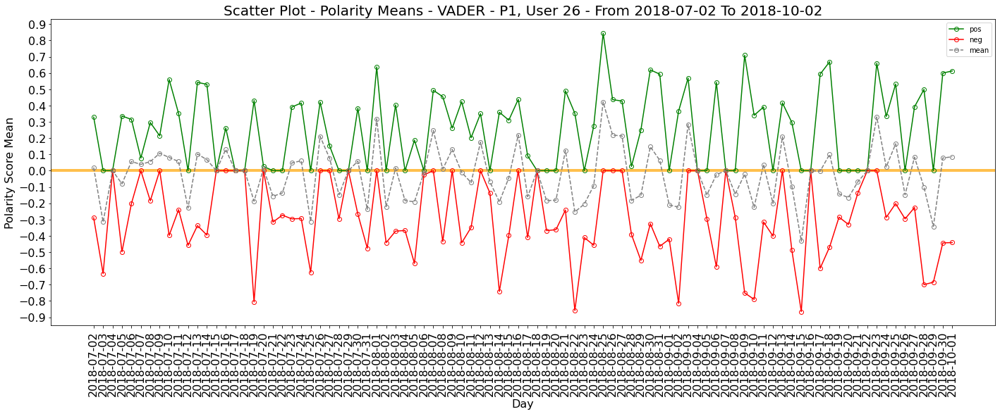

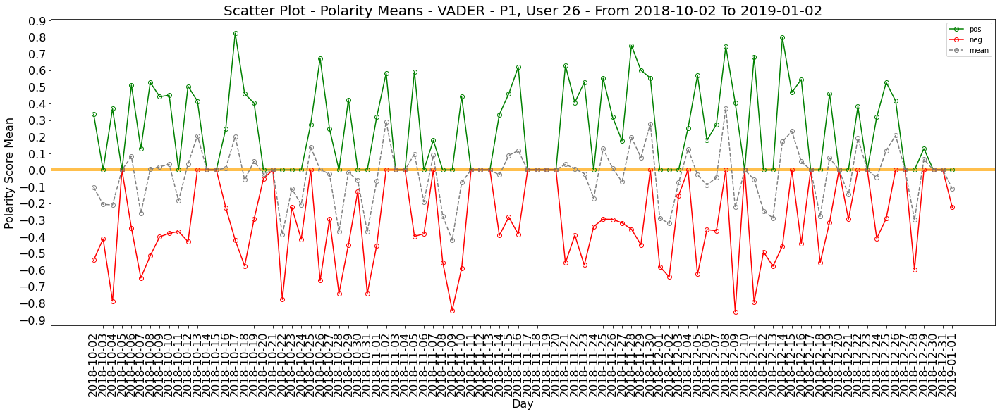

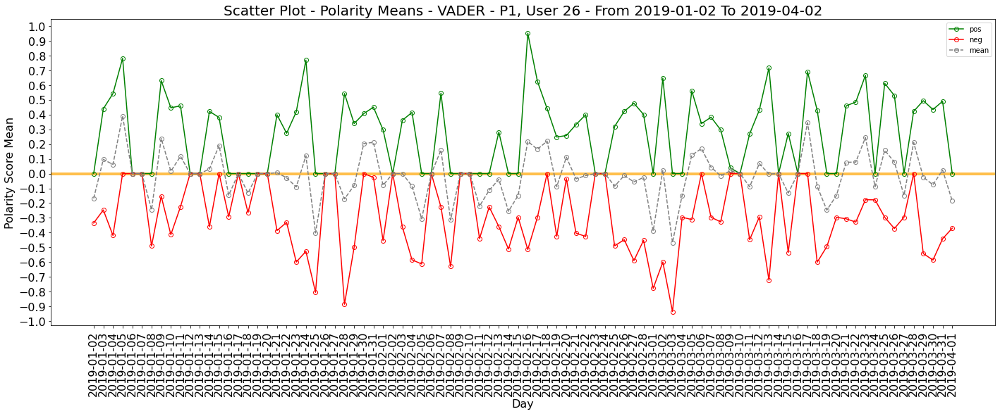

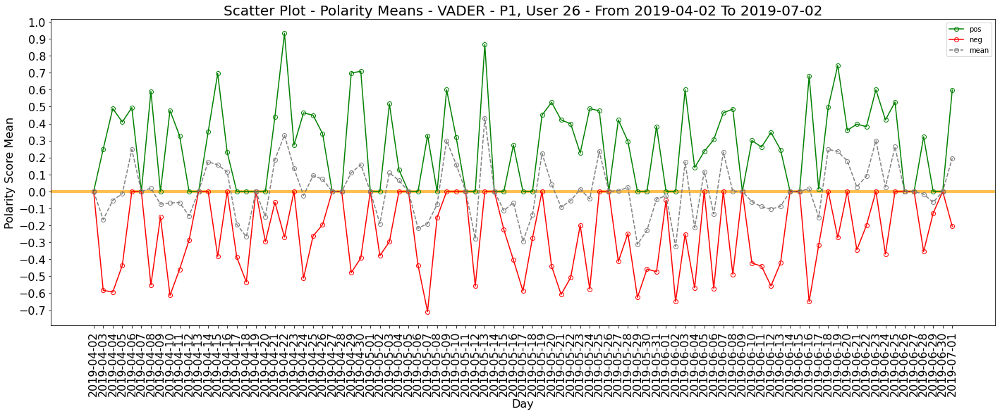

...

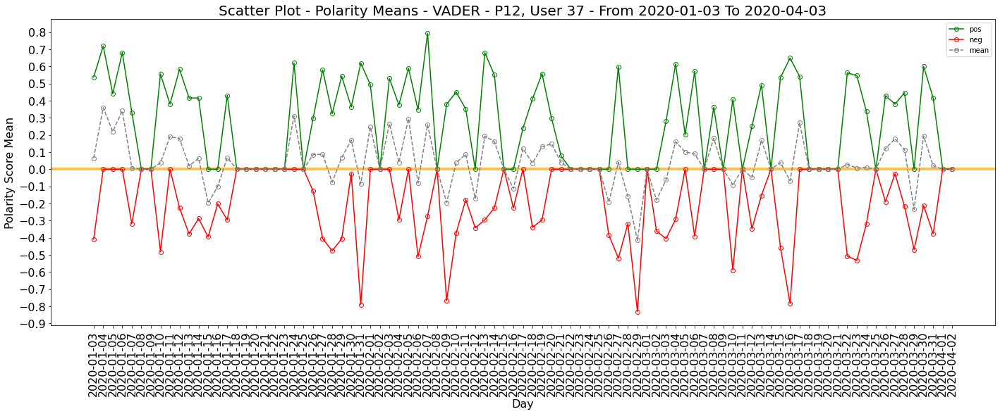

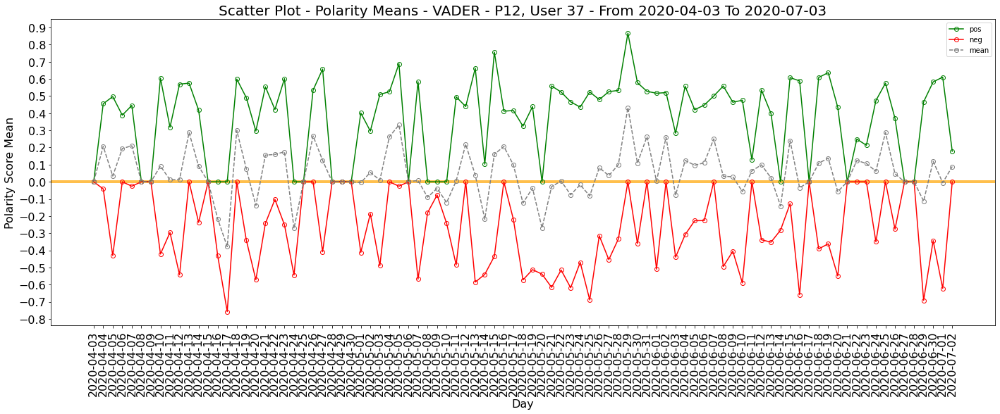

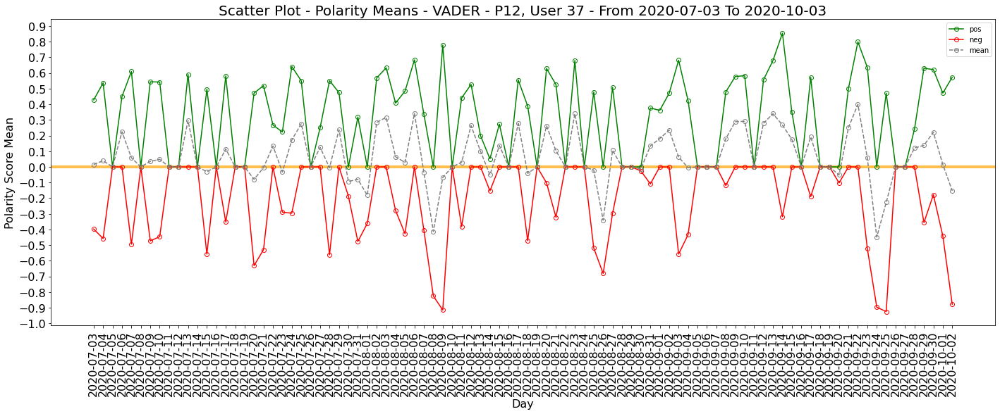

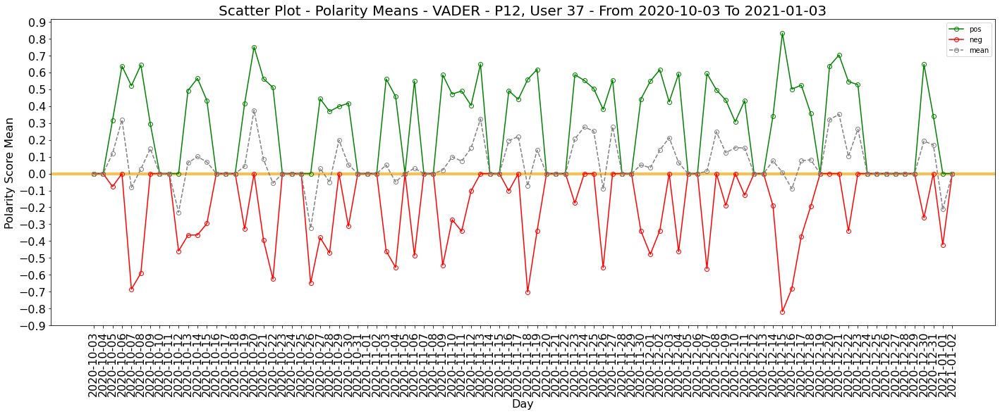

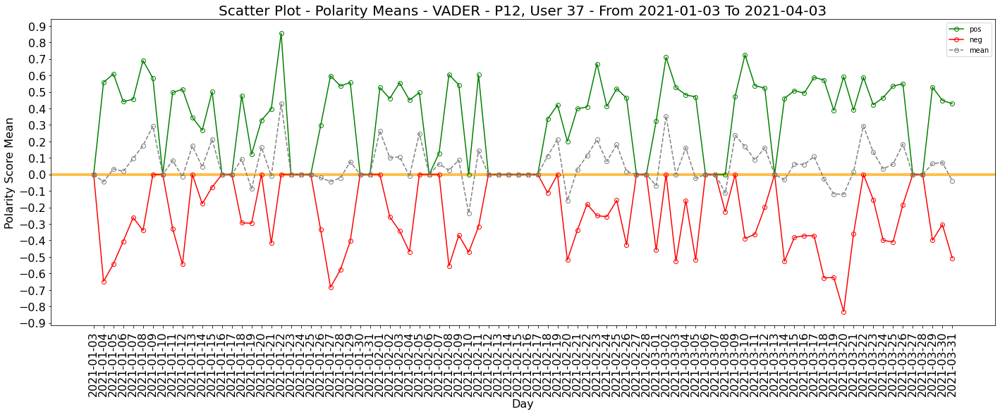

In [80]:
count = 1
for c in data:
    id_user = c
    tweets_pd = create_tweets_pd(data, id_user)
    df = pd.DataFrame(tweets_pd)
    clean_df(df)
    
    df = df.sort_values(by='created_at')
    
    df["created_at"] = pd.to_datetime(df["created_at"])
    df['date_minus_time'] = df["created_at"].apply( lambda df : datetime.datetime(year=df.year, month=df.month, day=df.day))
    df.set_index(df["date_minus_time"],inplace=True)
    
    df_pos = df.query(alg_to_analyze[1] + " == 'pos'")
    df_pos = pd.DataFrame(df_pos[alg_to_analyze[0]].resample('D').mean())
    
    df_neg = df.query(alg_to_analyze[1] + " == 'neg'")
    df_neg = pd.DataFrame(df_neg[alg_to_analyze[0]].resample('D').mean())
    
    df_final = pd.merge(df_pos, df_neg, how="outer", on=["date_minus_time"])
    df_final = df_final.fillna(0)
    df_final.columns = ['vader_score_pos', 'vader_score_neg']
    
    df_final['mean'] = df_final.iloc[:, [0,1]].mean(axis=1)
    
    plot_point_chart_pos_neg(df_final, count, id_user)
    
    count += 1

In [34]:
# Function to calculate correlation coefficient between two arrays
def corr(x, y, **kwargs):
    
    # Calculate the value
    coef = np.corrcoef(x, y)[0][1]
    # Make the label
    label = r'$\rho$ = ' + str(round(coef, 2))
    
    # Add the label to the plot
    ax = plt.gca()
    ax.annotate(label, xy = (0.2, 0.95), size = 20, xycoords = ax.transAxes)

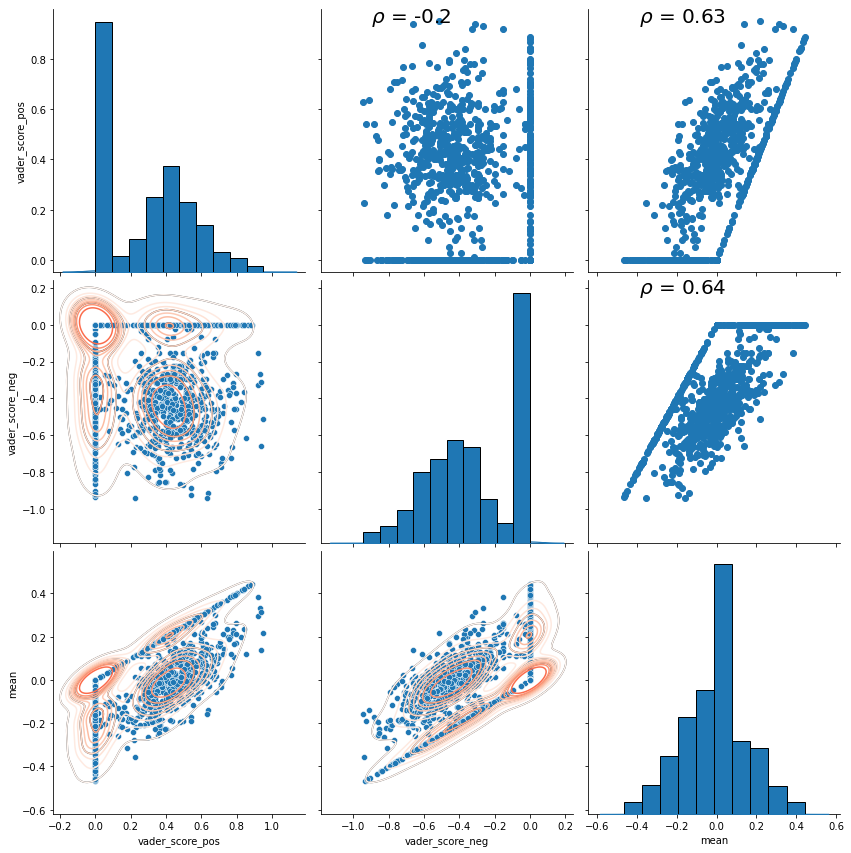

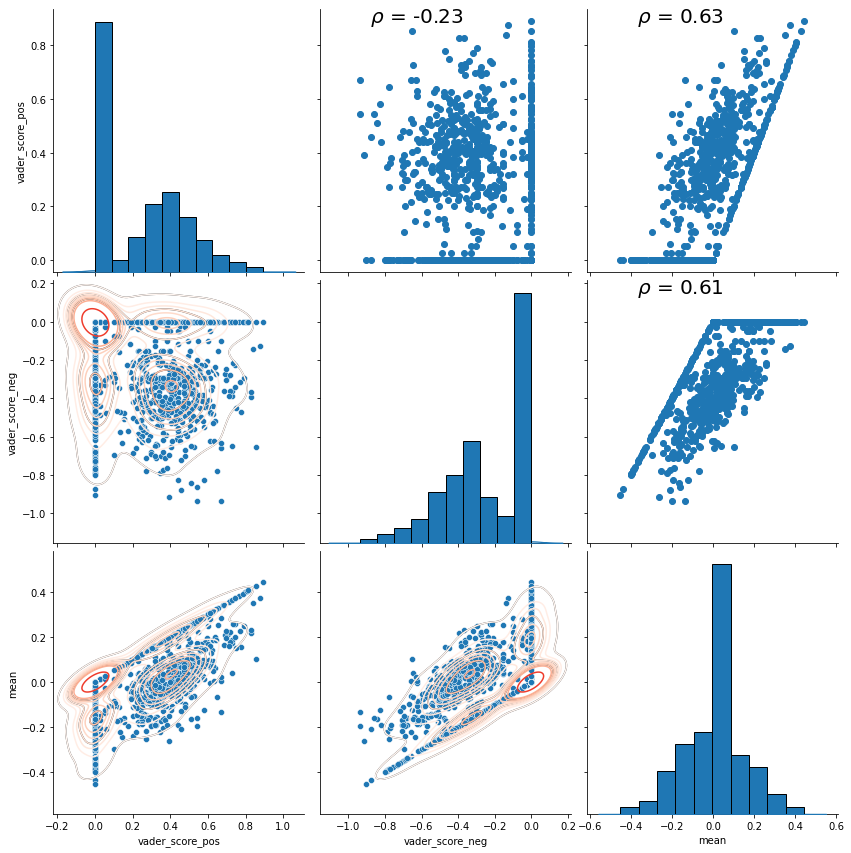

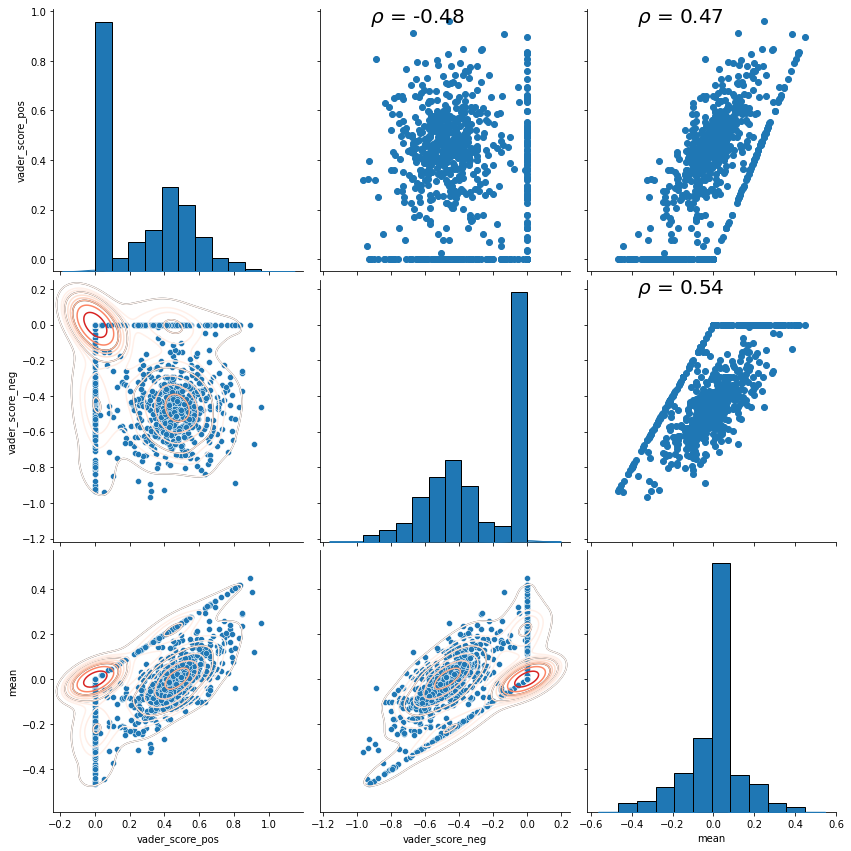

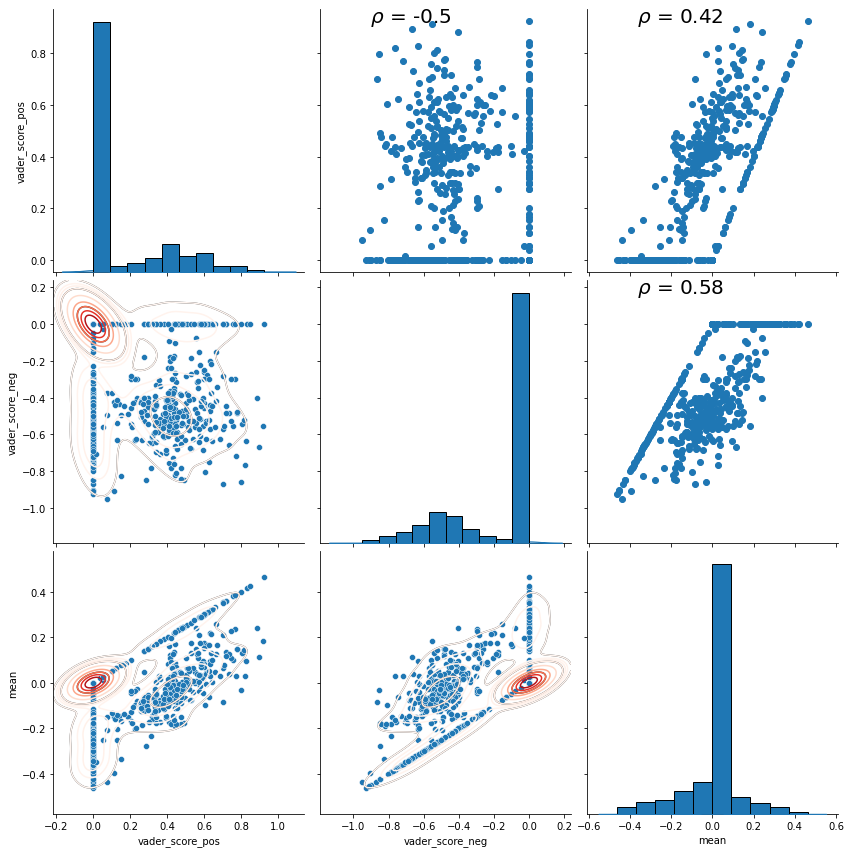

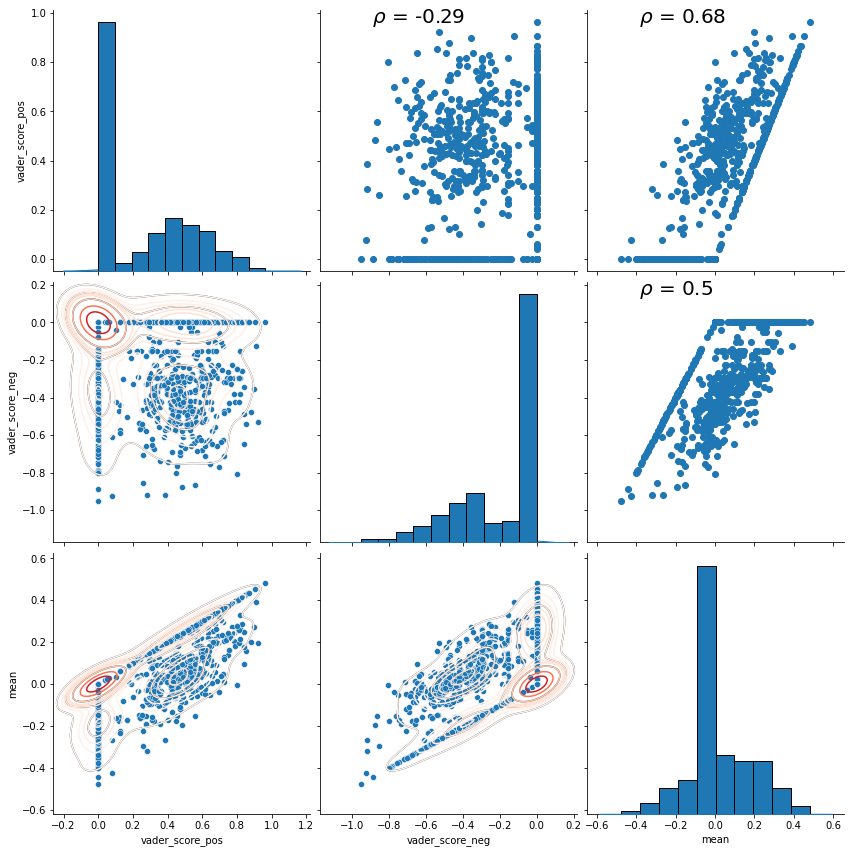

...

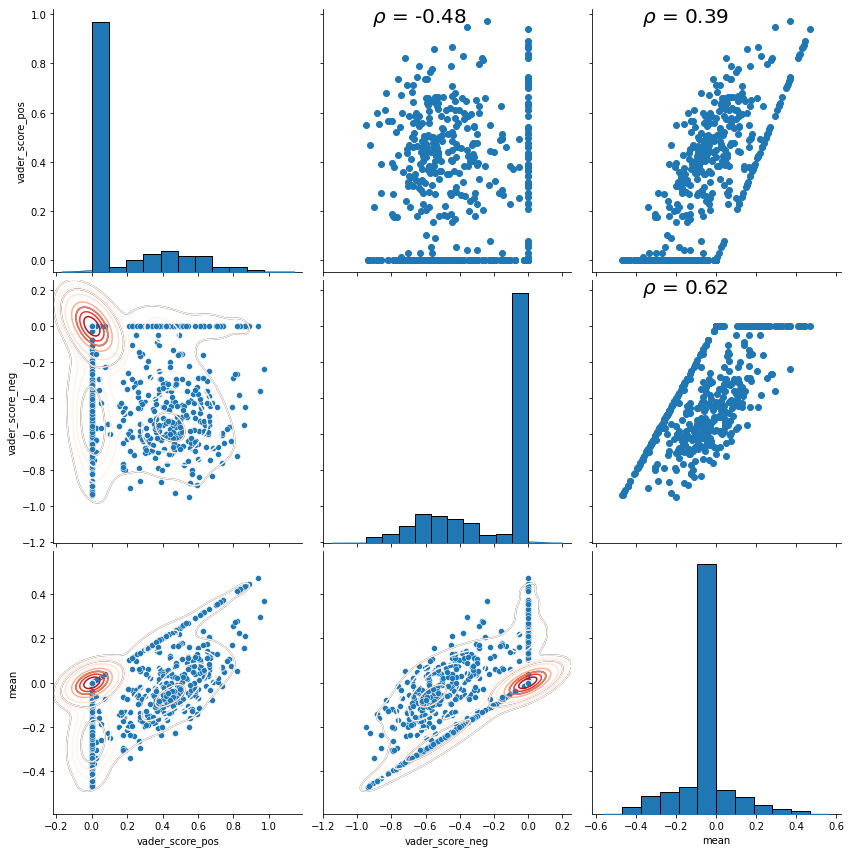

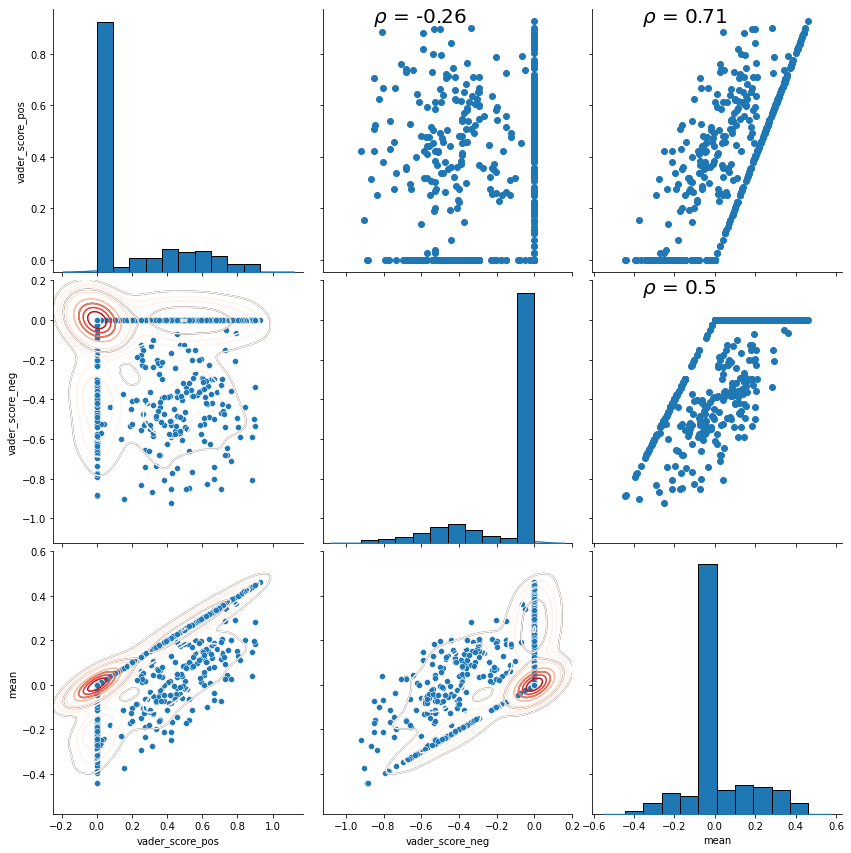

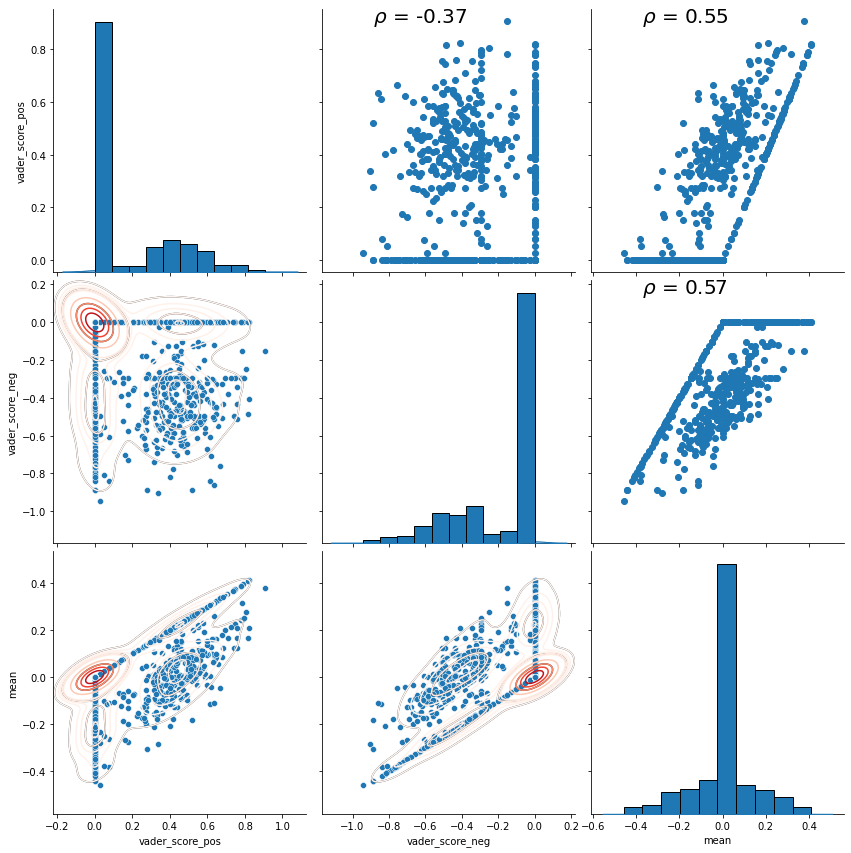

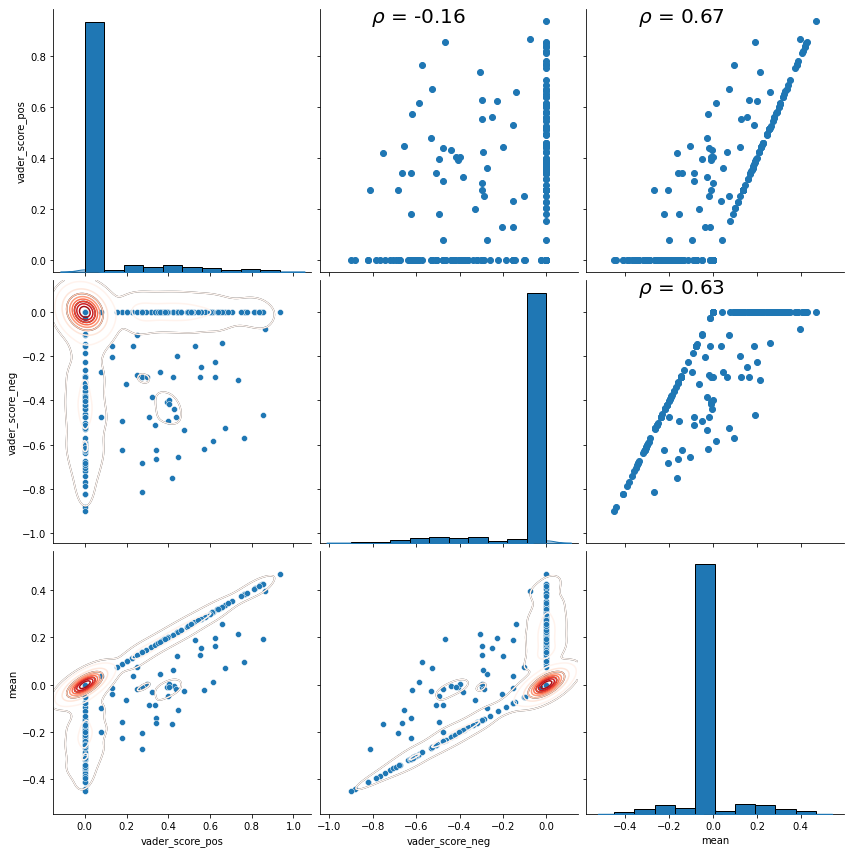

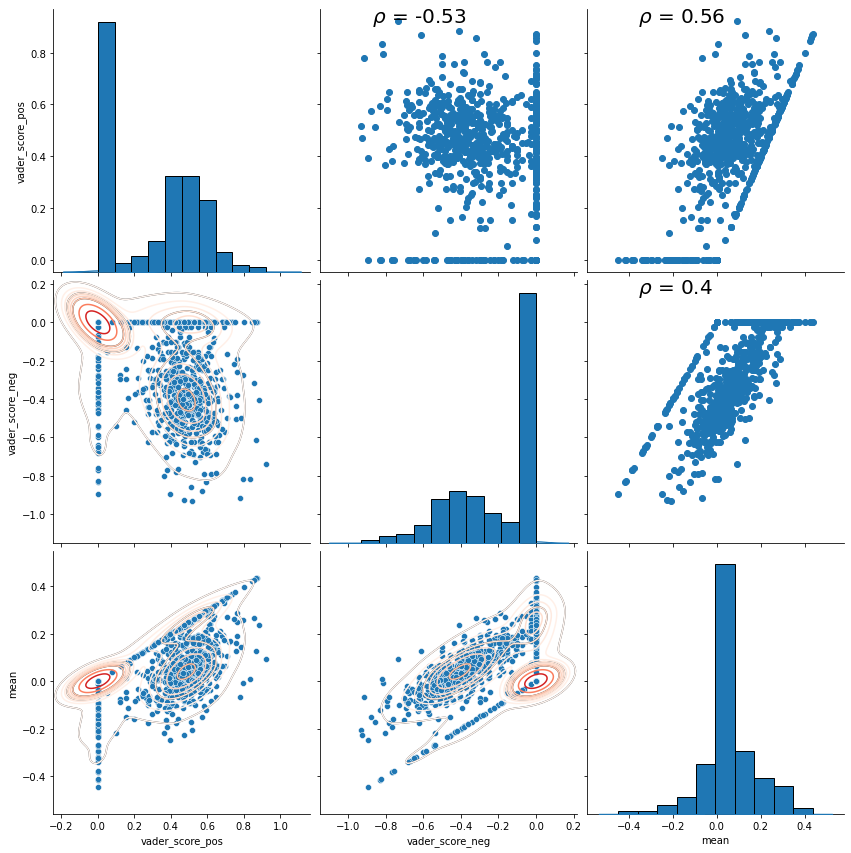

In [81]:
count = 1
for c in data:
    id_user = c
    tweets_pd = create_tweets_pd(data, id_user)
    df = pd.DataFrame(tweets_pd)
    
    clean_df(df)

    df = df.sort_values(by='created_at')

    df["created_at"] = pd.to_datetime(df["created_at"])
    df['date_minus_time'] = df["created_at"].apply( lambda df : datetime.datetime(year=df.year, month=df.month, day=df.day))
    df.set_index(df["date_minus_time"],inplace=True)

    df_pos = df.query(alg_to_analyze[1] + " == 'pos'")
    df_pos = pd.DataFrame(df_pos[alg_to_analyze[0]].resample('D').mean())

    df_neg = df.query(alg_to_analyze[1] + " == 'neg'")
    df_neg = pd.DataFrame(df_neg[alg_to_analyze[0]].resample('D').mean())

    df_final = pd.merge(df_pos, df_neg, how="outer", on=["date_minus_time"])
    df_final = df_final.fillna(0)
    df_final.columns = ['vader_score_pos', 'vader_score_neg']

    df_final['mean'] = df_final.iloc[:, [0,1]].mean(axis=1)

    g = sns.pairplot(df_final, diag_kind="kde", height=4)
    g.map_lower(sns.kdeplot, levels=4, color=".2")

    # Map the plots to the locations
    g = g.map_upper(plt.scatter)
    g = g.map_upper(corr)
    g = g.map_lower(sns.kdeplot, cmap = 'Reds')
    g = g.map_diag(plt.hist, bins = 10, edgecolor =  'k');
    
    count += 1

In [36]:
df_final

,vader_score_pos,vader_score_neg,mean
date_minus_time,,,
2018-04-03,0.565250,-0.312650,0.126300
2018-04-04,0.511000,-0.239333,0.135833
2018-04-05,0.399950,-0.440980,-0.020515
2018-04-06,0.647150,-0.624100,0.011525
2018-04-07,0.000000,0.000000,0.000000
...,...,...,...
2021-03-27,0.000000,0.000000,0.000000
2021-03-28,0.000000,0.000000,0.000000
2021-03-29,0.528885,-0.399126,0.064879


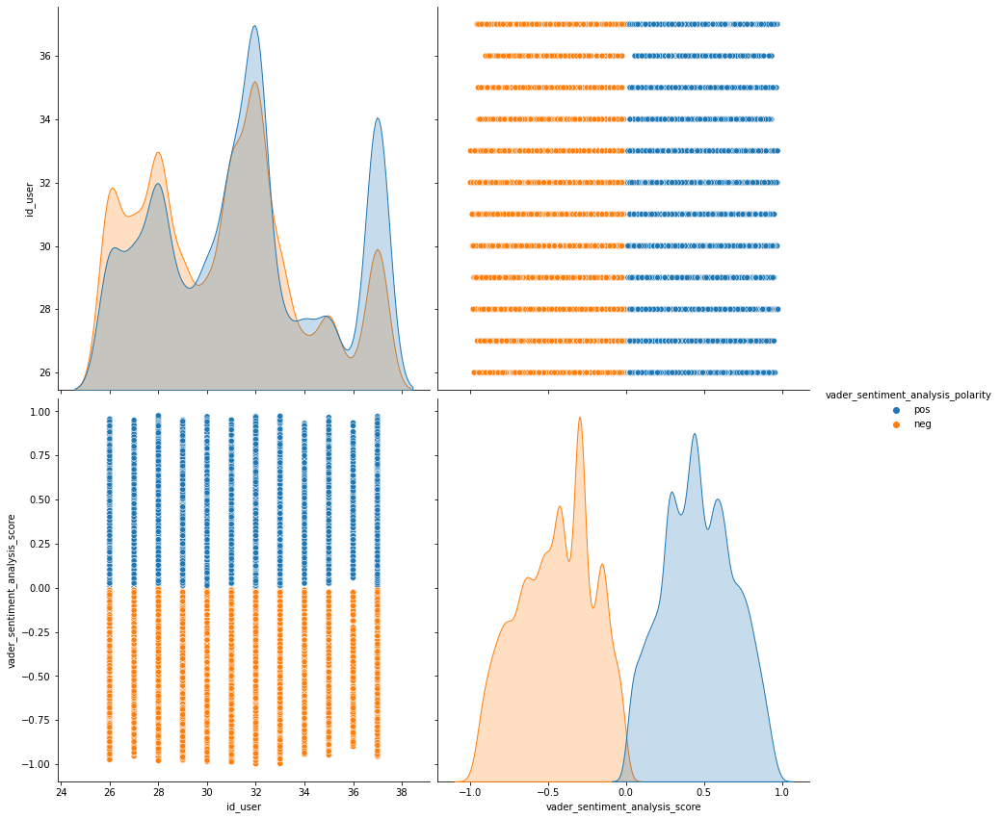

In [37]:
tweets = [data[d]['tweets'] for d in data]

final_tweets = []
for i in tweets:
    final_tweets.extend(i)

df = pd.DataFrame(final_tweets)

del df[0]
del df[1]
del df[4]
del df[5]
del df[6]
del df[18]

df.columns = ["text", "created_at", "id_user", "vader_sentiment_analysis_score", "vader_sentiment_analysis_polarity",
                         "oplexicon_sentiment_analysis_score", "oplexicon_sentiment_analysis_polarity",
                         "sentistrength_sentiment_analysis_score", "sentistrength_sentiment_analysis_polarity",
                         "sentilexpt_sentiment_analysis_score", "sentilexpt_sentiment_analysis_polarity",
                         "final_score", "final_polarity"]

clean_df(df)

df = df.sort_values(by='created_at')

# print(df)

df["created_at"] = pd.to_datetime(df["created_at"])
df['date_minus_time'] = df["created_at"].apply( lambda df : datetime.datetime(year=df.year, month=df.month, day=df.day))
# df.set_index(df["date_minus_time"],inplace=True)

df_final = df.query("vader_sentiment_analysis_polarity == 'pos' or vader_sentiment_analysis_polarity == 'neg'")

# df_pos = pd.DataFrame(df_pos['final_score'].resample('D').mean())
# df_pos['final_score_mean'] = df_pos['final_score'].resample('D').mean()

# print(df_pos)


# df_neg = df.query("final_polarity == 'neg'")
# df_neg = pd.DataFrame(df_neg['final_score'].resample('D').mean())

# df_final = pd.merge(df_pos, df_neg, how="outer", on=["date_minus_time"])
# df_final = df_final.fillna(0)
# df_final.columns = ['final_score_pos', 'final_score_neg']

# df_final['mean'] = df_final.iloc[:, [0,1]].mean(axis=1)

# df_final.head()

sns.pairplot(df_final, diag_kind="kde", height=6, hue="vader_sentiment_analysis_polarity")

Text(0.5, 1.02, 'PairPlot')

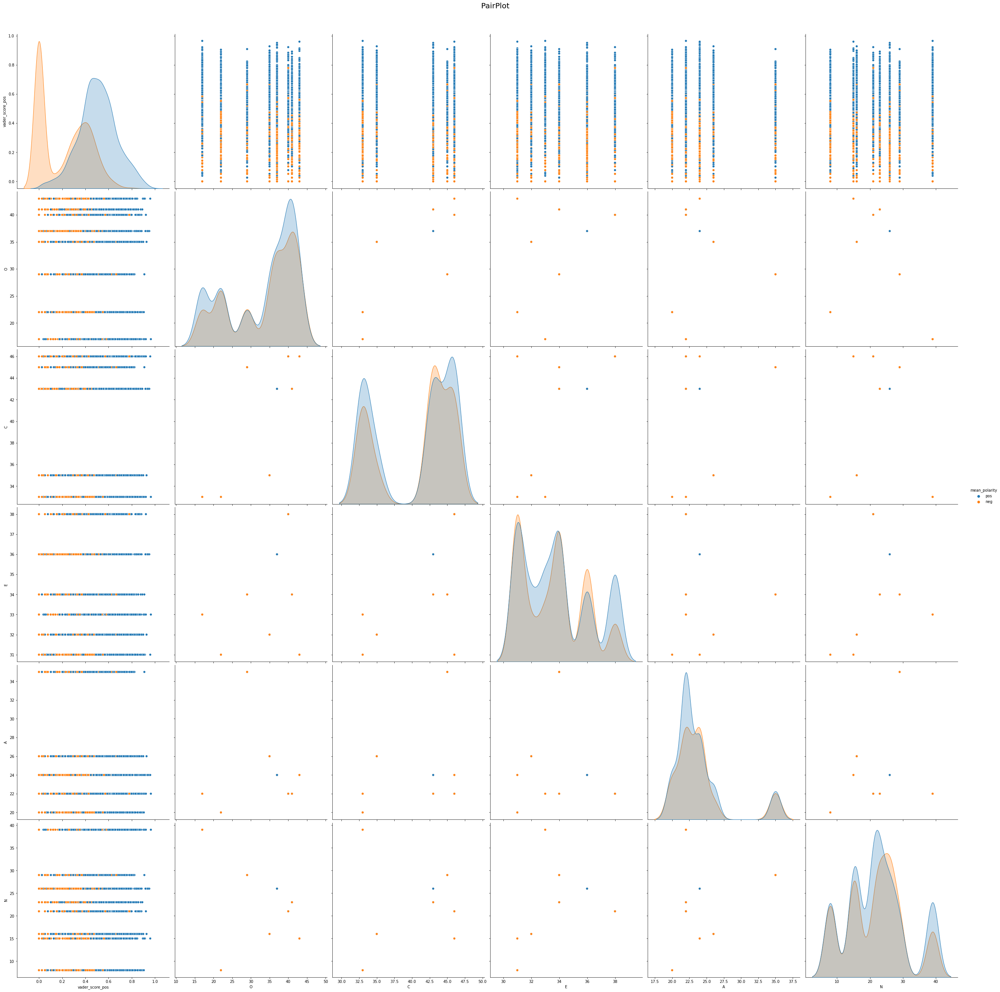

In [85]:
frames = []

count = 1
for c in data:
    id_user = c
    
    df_bf = pd.DataFrame(data[id_user]['bigfive'])
    
    if df_bf.empty == False:
        tweets_pd = create_tweets_pd(data, id_user)
        df = pd.DataFrame(tweets_pd)

        clean_df(df)

        df = df.sort_values(by='created_at')

        df["created_at"] = pd.to_datetime(df["created_at"])
        df['date_minus_time'] = df["created_at"].apply( lambda df : datetime.datetime(year=df.year, month=df.month, day=df.day))
        df.set_index(df["date_minus_time"],inplace=True)

        df_pos = df.query(alg_to_analyze[1] + " == 'pos'")

        df_pos = pd.DataFrame(df_pos[alg_to_analyze[0]].resample('D').mean())

        df_neg = df.query(alg_to_analyze[1] + " == 'neg'")
        df_neg = pd.DataFrame(df_neg[alg_to_analyze[0]].resample('D').mean())

        df_final = pd.merge(df_pos, df_neg, how="outer", on=["date_minus_time"])
        df_final = df_final.fillna(0)
        df_final.columns = ['vader_score_pos', 'vader_score_neg']

        df_final['mean'] = df_final.iloc[:, [0,1]].mean(axis=1)
        df_final.loc[df_final['mean'] > 0, ['mean_polarity']] = 'pos'
        df_final.loc[df_final['mean'] < 0, ['mean_polarity']] = 'neg'

    #     df_final = df_final.drop(df_final["mean_polarity"])
        df_final = df_final.dropna(how = 'any')

        df_final['id_user'] = id_user
        
        df_final['O'] = int(bigfive[id_user]['O'])
        df_final['C'] = int(bigfive[id_user]['C'])
        df_final['E'] = int(bigfive[id_user]['E'])
        df_final['A'] = int(bigfive[id_user]['A'])
        df_final['N'] = int(bigfive[id_user]['N'])

    #     g = sns.pairplot(df_final, diag_kind="kde", height=4)

        count += 1
        
        frames.append(df_final)

#         g = sns.pairplot(df_final, diag_kind="kde", height=6, hue="mean_polarity")
#         g.fig.suptitle("PairPlot - P{} - U{}".format(count, id_user), fontsize=20, y=1.02) # y= some height>1
    #     g.map_lower(sns.kdeplot, levels=4, color=".2")

    #     # Map the plots to the locations
    #     g = g.map_upper(plt.scatter)
    #     g = g.map_upper(corr)
    #     g = g.map_lower(sns.kdeplot)
    #     g = g.map_diag(plt.hist, bins = 10, edgecolor =  'k');

    
result = pd.concat(frames)

# print(result)

# print(result.loc[result['mean_polarity'] == 'neg'])

g = sns.pairplot(result, diag_kind="kde", height=6, hue="mean_polarity", vars=['vader_score_pos', 
                                                                            'O',
                                                                            'C',
                                                                            'E',
                                                                            'A',
                                                                            'N'
                                                                              ])
g.fig.suptitle("PairPlot", fontsize=20, y=1.02) # y= some height>1

In [39]:
ids = result['id_user'].unique()
bf = ['O', 'C', 'E', 'A', 'N']

for b in bf:
    df_chart[b] = 0

for i in ids:
    for b in bf:
        df_chart.loc[df_chart['id_user'] == i, b] = int(bigfive[i][b])
        
        
df_chart.head()

,id_user,pos,neu,neg,por_pos,por_neu,por_neg,mean_all,mean_posneg,O,C,E,A,N
0,26,1495,1423,2121,29.668585,28.239730,42.091685,-0.062129,-0.086579,37,43,36,24,26
1,27,1335,1626,1588,29.347109,35.744120,34.908771,-0.016253,-0.025294,41,43,34,22,23
2,28,2217,1264,2452,37.367268,21.304568,41.328165,-0.025317,-0.032171,43,46,31,24,15
3,29,887,1271,1191,26.485518,37.951627,35.562855,-0.055769,-0.089880,0,0,0,0,0
4,30,1246,948,978,39.281211,29.886507,30.832282,0.069618,0.099293,17,33,33,22,39


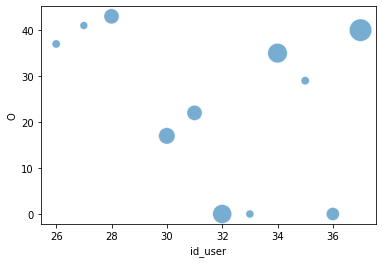

In [40]:

sns.scatterplot(data=df_chart, x="id_user", y="O", 
                size='por_pos', 
                legend=False, 
                sizes=(0, 500),
                cmap="Accent",
                alpha=0.6)


plt.show()

In [41]:
df_chart = df_chart.drop(df_chart[df_chart['O'] == 0].index)
df_chart

,id_user,pos,neu,neg,por_pos,por_neu,por_neg,mean_all,mean_posneg,O,C,E,A,N
0,26,1495,1423,2121,29.668585,28.239730,42.091685,-0.062129,-0.086579,37,43,36,24,26
1,27,1335,1626,1588,29.347109,35.744120,34.908771,-0.016253,-0.025294,41,43,34,22,23
2,28,2217,1264,2452,37.367268,21.304568,41.328165,-0.025317,-0.032171,43,46,31,24,15
4,30,1246,948,978,39.281211,29.886507,30.832282,0.069618,0.099293,17,33,33,22,39
5,31,2244,1442,2310,37.424950,24.049366,38.525684,-0.004537,-0.005974,22,33,31,20,8
8,34,689,397,459,44.595469,25.695793,29.708738,0.090511,0.121811,35,35,32,26,16
9,35,772,1035,788,29.749518,39.884393,30.366089,0.002503,0.004163,29,45,34,35,29
11,37,3243,1631,1582,50.232342,25.263321,24.504337,0.146560,0.196102,40,46,38,22,21


In [42]:
pos_list = df_chart['pos'].tolist()
o_list = df_chart['O'].tolist()
c_list = df_chart['C'].tolist()
e_list = df_chart['E'].tolist()
a_list = df_chart['A'].tolist()
n_list = df_chart['N'].tolist()

print('pos: mean=%.3f stdv=%.3f' % (np.mean(pos_list), np.std(pos_list)))
print('o: mean=%.3f stdv=%.3f' % (np.mean(o_list), np.std(o_list)))
print('c: mean=%.3f stdv=%.3f' % (np.mean(c_list), np.std(c_list)))
print('e: mean=%.3f stdv=%.3f' % (np.mean(e_list), np.std(e_list)))
print('a: mean=%.3f stdv=%.3f' % (np.mean(a_list), np.std(a_list)))
print('n: mean=%.3f stdv=%.3f' % (np.mean(n_list), np.std(n_list)))

r = np.corrcoef(pos_list, o_list)
print('r x o', r)
r = np.corrcoef(pos_list, c_list)
print('r x c', r)
r = np.corrcoef(pos_list, e_list)
print('r x e', r)
r = np.corrcoef(pos_list, a_list)
print('r x a', r)
r = np.corrcoef(pos_list, n_list)
print('r x n', r)

print('pearsonr pos x o: ',scipy.stats.pearsonr(pos_list, o_list))    # Pearson's r
print('pearsonr pos x c: ',scipy.stats.pearsonr(pos_list, c_list))    # Pearson's r
print('pearsonr pos x e: ',scipy.stats.pearsonr(pos_list, e_list))    # Pearson's r
print('pearsonr pos x a: ',scipy.stats.pearsonr(pos_list, a_list))    # Pearson's r
print('pearsonr pos x n: ',scipy.stats.pearsonr(pos_list, n_list))    # Pearson's r
print('spearmanr pos x o: ',scipy.stats.spearmanr(pos_list, o_list))   # Spearman's rho
print('spearmanr pos x c: ',scipy.stats.spearmanr(pos_list, c_list))   # Spearman's rho
print('spearmanr pos x e: ',scipy.stats.spearmanr(pos_list, e_list))   # Spearman's rho
print('spearmanr pos x a: ',scipy.stats.spearmanr(pos_list, a_list))   # Spearman's rho
print('spearmanr pos x n: ',scipy.stats.spearmanr(pos_list, n_list))   # Spearman's rho
print('kendalltau pos x o: ',scipy.stats.kendalltau(pos_list, o_list))  # Kendall's tau
print('kendalltau pos x c: ',scipy.stats.kendalltau(pos_list, c_list))  # Kendall's tau
print('kendalltau pos x e: ',scipy.stats.kendalltau(pos_list, e_list))  # Kendall's tau
print('kendalltau pos x a: ',scipy.stats.kendalltau(pos_list, a_list))  # Kendall's tau
print('kendalltau pos x n: ',scipy.stats.kendalltau(pos_list, n_list))  # Kendall's tau

pos: mean=1655.125 stdv=805.655
o: mean=33.000 stdv=8.846
c: mean=40.500 stdv=5.431
e: mean=33.625 stdv=2.288
a: mean=24.375 stdv=4.357
n: mean=22.125 stdv=8.922
r x o [[1.       0.266619]
 [0.266619 1.      ]]
r x c [[1.         0.30321428]
 [0.30321428 1.        ]]
r x e [[1.         0.33367748]
 [0.33367748 1.        ]]
r x a [[ 1.         -0.55975533]
 [-0.55975533  1.        ]]
r x n [[ 1.         -0.38371173]
 [-0.38371173  1.        ]]
pearsonr pos x o:  (0.2666190026327291, 0.5232751383817952)
pearsonr pos x c:  (0.30321427738551215, 0.46535858887873865)
pearsonr pos x e:  (0.33367748253916285, 0.4192433673769371)
pearsonr pos x a:  (-0.5597553281173964, 0.14908378704789438)
pearsonr pos x n:  (-0.383711734181709, 0.3480408019861874)
spearmanr pos x o:  SpearmanrResult(correlation=0.3333333333333334, pvalue=0.4197530864197531)
spearmanr pos x c:  SpearmanrResult(correlation=0.32732683535398854, pvalue=0.4286915072353138)
spearmanr pos x e:  SpearmanrResult(correlation=0.1084416

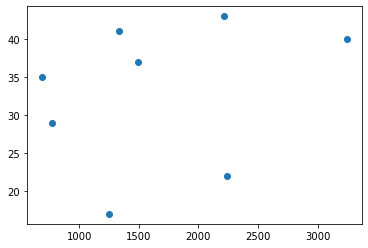

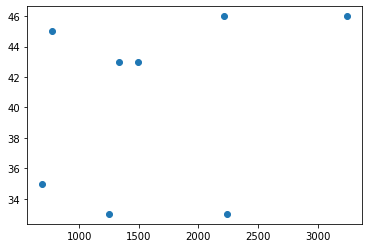

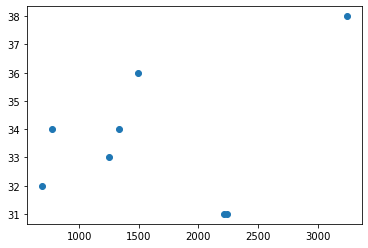

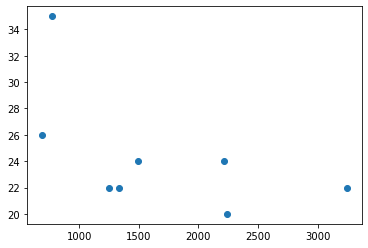

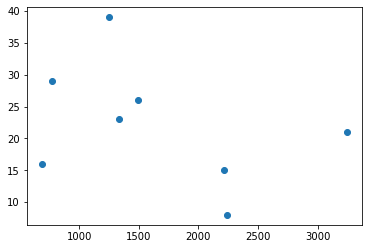

In [43]:
plt.scatter(pos_list, o_list)
plt.show()

plt.scatter(pos_list, c_list)
plt.show()

plt.scatter(pos_list, e_list)
plt.show()

plt.scatter(pos_list, a_list)
plt.show()

plt.scatter(pos_list, n_list)
plt.show()

In [44]:
slope, intercept, r, p, stderr = scipy.stats.linregress(pos_list, o_list)
o_line = f'Regression line: y={intercept:.2f}+{slope:.2f}x, r={r:.2f}'
slope, intercept, r, p, stderr = scipy.stats.linregress(pos_list, c_list)
c_line = f'Regression line: y={intercept:.2f}+{slope:.2f}x, r={r:.2f}'
slope, intercept, r, p, stderr = scipy.stats.linregress(pos_list, e_list)
e_line = f'Regression line: y={intercept:.2f}+{slope:.2f}x, r={r:.2f}'
slope, intercept, r, p, stderr = scipy.stats.linregress(pos_list, a_list)
a_line = f'Regression line: y={intercept:.2f}+{slope:.2f}x, r={r:.2f}'
slope, intercept, r, p, stderr = scipy.stats.linregress(pos_list, n_list)
n_line = f'Regression line: y={intercept:.2f}+{slope:.2f}x, r={r:.2f}'


print('o x pos: ',o_line)
print('c x pos: ',c_line)
print('e x pos: ',e_line)
print('a x pos: ',a_line)
print('n x pos: ',n_line)

o x pos:  Regression line: y=28.15+0.00x, r=0.27
c x pos:  Regression line: y=37.12+0.00x, r=0.30
e x pos:  Regression line: y=32.06+0.00x, r=0.33
a x pos:  Regression line: y=29.39+-0.00x, r=-0.56
n x pos:  Regression line: y=29.16+-0.00x, r=-0.38


NameError: name 'x' is not defined

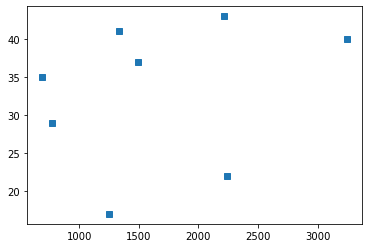

In [45]:
fig, ax = plt.subplots()
ax.plot(pos_list, o_list, linewidth=0, marker='s', label='Data points')
ax.plot(x, intercept + slope * x, label=o_line)
ax.set_xlabel('x')
ax.set_ylabel('y')
ax.legend(facecolor='white')
plt.show()

In [46]:
pg.corr(x=df_chart['pos'], y=df_chart['O'])

,n,r,CI95%,r2,adj_r2,p-val,BF10,power
pearson,8,0.266619,"[-0.54, 0.82]",0.071086,-0.30048,0.523275,0.514,0.098512


In [47]:
pg.pairwise_corr(df_chart).sort_values(by=['p-unc'])[['X', 'Y', 'n', 'r', 'p-unc']].head()

,X,Y,n,r,p-unc
70,mean_all,mean_posneg,8,0.999582,1.825840e-10
63,por_neg,mean_all,8,-0.897033,2.522736e-03
64,por_neg,mean_posneg,8,-0.894479,2.709804e-03
49,por_pos,mean_posneg,8,0.886849,3.321359e-03
48,por_pos,mean_all,8,0.886703,3.333837e-03


In [48]:
corr_pos = pg.pairwise_corr(df_chart, columns=[['pos'],['O', 'C', 'E', 'A', 'N']], method='spearman')
corr_pos

,X,Y,method,tail,n,r,CI95%,r2,adj_r2,z,p-unc,power
0,pos,O,spearman,two-sided,8,0.333333,"[-0.49, 0.84]",0.111111,-0.244444,0.346574,0.419753,0.129523
1,pos,C,spearman,two-sided,8,0.327327,"[-0.49, 0.84]",0.107143,-0.250000,0.339831,0.428692,0.126347
2,pos,E,spearman,two-sided,8,0.108442,"[-0.65, 0.76]",0.011760,-0.383537,0.108870,0.798260,0.056659
3,pos,A,spearman,two-sided,8,-0.650613,"[-0.93, 0.1]",0.423297,0.192616,-0.776361,0.080638,0.448655
4,pos,N,spearman,two-sided,8,-0.476190,"[-0.88, 0.34]",0.226757,-0.082540,-0.518046,0.232936,0.231939


In [49]:
corr_neg = pg.pairwise_corr(df_chart, columns=[['neg'],['O', 'C', 'E', 'A', 'N']], method='spearman')
corr_neg

,X,Y,method,tail,n,r,CI95%,r2,adj_r2,z,p-unc,power
0,neg,O,spearman,two-sided,8,0.428571,"[-0.4, 0.87]",0.183673,-0.142857,0.458145,0.289403,0.191546
1,neg,C,spearman,two-sided,8,0.181848,"[-0.6, 0.79]",0.033069,-0.353704,0.183893,0.666477,0.071134
2,neg,E,spearman,two-sided,8,-0.289178,"[-0.83, 0.52]",0.083624,-0.282927,-0.297669,0.487261,0.107984
3,neg,A,spearman,two-sided,8,-0.466477,"[-0.88, 0.35]",0.217601,-0.095359,-0.505558,0.243955,0.223132
4,neg,N,spearman,two-sided,8,-0.500000,"[-0.89, 0.32]",0.250000,-0.050000,-0.549306,0.207031,0.254830


In [50]:
corr_mean_pn = pg.pairwise_corr(df_chart, columns=[['mean_posneg'],['O', 'C', 'E', 'A', 'N']], method='spearman')
corr_mean_pn

,X,Y,method,tail,n,r,CI95%,r2,adj_r2,z,p-unc,power
0,mean_posneg,O,spearman,two-sided,8,-0.357143,"[-0.85, 0.46]",0.127551,-0.221429,-0.373607,0.385121,0.142916
1,mean_posneg,C,spearman,two-sided,8,-0.072739,"[-0.74, 0.67]",0.005291,-0.392593,-0.072868,0.864094,0.052388
2,mean_posneg,E,spearman,two-sided,8,0.168687,"[-0.61, 0.78]",0.028455,-0.360163,0.170315,0.689661,0.067947
3,mean_posneg,A,spearman,two-sided,8,-0.036827,"[-0.72, 0.69]",0.001356,-0.398101,-0.036844,0.931012,0.049817
4,mean_posneg,N,spearman,two-sided,8,0.071429,"[-0.67, 0.74]",0.005102,-0.392857,0.071550,0.866526,0.052264


In [51]:
corr_mean_all = pg.pairwise_corr(df_chart, columns=[['mean_all'],['O', 'C', 'E', 'A', 'N']], method='spearman')
corr_mean_all

,X,Y,method,tail,n,r,CI95%,r2,adj_r2,z,p-unc,power
0,mean_all,O,spearman,two-sided,8,-0.357143,"[-0.85, 0.46]",0.127551,-0.221429,-0.373607,0.385121,0.142916
1,mean_all,C,spearman,two-sided,8,-0.072739,"[-0.74, 0.67]",0.005291,-0.392593,-0.072868,0.864094,0.052388
2,mean_all,E,spearman,two-sided,8,0.168687,"[-0.61, 0.78]",0.028455,-0.360163,0.170315,0.689661,0.067947
3,mean_all,A,spearman,two-sided,8,-0.036827,"[-0.72, 0.69]",0.001356,-0.398101,-0.036844,0.931012,0.049817
4,mean_all,N,spearman,two-sided,8,0.071429,"[-0.67, 0.74]",0.005102,-0.392857,0.071550,0.866526,0.052264


In [52]:
df_chart.corr(method='spearman').round(4)

,id_user,pos,neu,neg,por_pos,por_neu,por_neg,mean_all,mean_posneg,O,C,E,A,N
id_user,1.0000,0.0000,-0.0476,-0.5476,0.7143,-0.0476,-0.8571,0.8571,0.8571,-0.2857,0.1818,0.1084,0.1228,-0.0952
pos,0.0000,1.0000,0.8095,0.7381,0.1429,-0.6429,0.2381,-0.1429,-0.1429,0.3333,0.3273,0.1084,-0.6506,-0.4762
neu,-0.0476,0.8095,1.0000,0.5238,-0.1667,-0.1905,0.0952,-0.1429,-0.1429,0.4524,0.3637,0.4338,-0.6015,-0.2619
neg,-0.5476,0.7381,0.5238,1.0000,-0.3571,-0.5952,0.7857,-0.7143,-0.7143,0.4286,0.1818,-0.2892,-0.4665,-0.5000
por_pos,0.7143,0.1429,-0.1667,-0.3571,1.0000,-0.4524,-0.6667,0.8333,0.8333,-0.2857,-0.0727,-0.0843,-0.1473,-0.2381
por_neu,-0.0476,-0.6429,-0.1905,-0.5952,-0.4524,1.0000,-0.2143,0.0476,0.0476,-0.2857,-0.1455,0.4820,0.3192,0.8333
por_neg,-0.8571,0.2381,0.0952,0.7857,-0.6667,-0.2143,1.0000,-0.9524,-0.9524,0.1905,-0.1091,-0.3012,-0.1350,-0.1429
mean_all,0.8571,-0.1429,-0.1429,-0.7143,0.8333,0.0476,-0.9524,1.0000,1.0000,-0.3571,-0.0727,0.1687,-0.0368,0.0714
mean_posneg,0.8571,-0.1429,-0.1429,-0.7143,0.8333,0.0476,-0.9524,1.0000,1.0000,-0.3571,-0.0727,0.1687,-0.0368,0.0714
O,-0.2857,0.3333,0.4524,0.4286,-0.2857,-0.2857,0.1905,-0.3571,-0.3571,1.0000,0.7638,0.1687,0.1350,-0.3333


In [53]:
pg.corr(df_chart['pos'], df_chart['A']).round(4)

,n,r,CI95%,r2,adj_r2,p-val,BF10,power
pearson,8,-0.5598,"[-0.91, 0.24]",0.3133,0.0387,0.1491,1.065,0.3211


Text(0.5, 1.0, 'Correlation matrix')

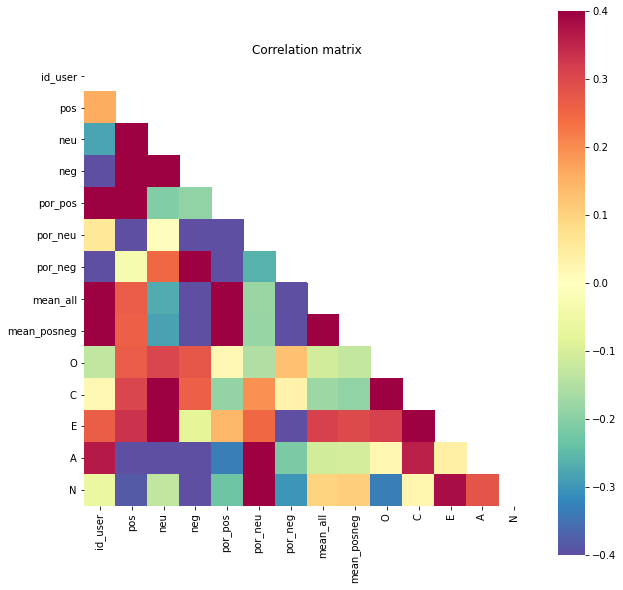

In [54]:
fig, ax = plt.subplots(figsize=(10,10))         # Sample figsize in inches

corrs = df_chart.corr()
mask = np.zeros_like(corrs)
mask[np.triu_indices_from(mask)] = True
sns.heatmap(corrs, cmap='Spectral_r', mask=mask, square=True, vmin=-.4, vmax=.4)
plt.title('Correlation matrix')

In [55]:
df_chart.rcorr(method='spearman', upper='pval', decimals=3, padjust=None, stars=False)

,id_user,pos,neu,neg,por_pos,por_neu,por_neg,mean_all,mean_posneg,O,C,E,A,N
id_user,-,1.,0.911,0.160,0.047,0.911,0.007,0.007,0.007,0.493,0.666,0.798,0.772,0.823
pos,0.0,-,0.015,0.037,0.736,0.086,0.570,0.736,0.736,0.42,0.429,0.798,0.081,0.233
neu,-0.048,0.81,-,0.183,0.693,0.651,0.823,0.736,0.736,0.260,0.376,0.283,0.115,0.531
neg,-0.548,0.738,0.524,-,0.385,0.12,0.021,0.047,0.047,0.289,0.666,0.487,0.244,0.207
por_pos,0.714,0.143,-0.167,-0.357,-,0.260,0.071,0.010,0.010,0.493,0.864,0.843,0.728,0.570
por_neu,-0.048,-0.643,-0.19,-0.595,-0.452,-,0.610,0.911,0.911,0.493,0.731,0.227,0.441,0.010
por_neg,-0.857,0.238,0.095,0.786,-0.667,-0.214,-,0.000,0.000,0.651,0.797,0.468,0.75,0.736
mean_all,0.857,-0.143,-0.143,-0.714,0.833,0.048,-0.952,-,0.,0.385,0.864,0.69,0.931,0.867
mean_posneg,0.857,-0.143,-0.143,-0.714,0.833,0.048,-0.952,1.0,-,0.385,0.864,0.69,0.931,0.867
O,-0.286,0.333,0.452,0.429,-0.286,-0.286,0.19,-0.357,-0.357,-,0.027,0.69,0.75,0.42


In [56]:
pg.homoscedasticity(df_chart)

,W,pval,equal_var
levene,0.507234,0.827276,True


In [57]:
pg.normality(df_chart)

,W,pval,normal
id_user,0.945988,0.670778,True
pos,0.923629,0.459993,True
neu,0.894933,0.259908,True
neg,0.933905,0.552276,True
por_pos,0.899017,0.283123,True
por_neu,0.923822,0.461633,True
por_neg,0.937298,0.584703,True
mean_all,0.928278,0.500539,True
mean_posneg,0.928065,0.498629,True
O,0.903375,0.309755,True


In [58]:
df_chart

,id_user,pos,neu,neg,por_pos,por_neu,por_neg,mean_all,mean_posneg,O,C,E,A,N
0,26,1495,1423,2121,29.668585,28.239730,42.091685,-0.062129,-0.086579,37,43,36,24,26
1,27,1335,1626,1588,29.347109,35.744120,34.908771,-0.016253,-0.025294,41,43,34,22,23
2,28,2217,1264,2452,37.367268,21.304568,41.328165,-0.025317,-0.032171,43,46,31,24,15
4,30,1246,948,978,39.281211,29.886507,30.832282,0.069618,0.099293,17,33,33,22,39
5,31,2244,1442,2310,37.424950,24.049366,38.525684,-0.004537,-0.005974,22,33,31,20,8
8,34,689,397,459,44.595469,25.695793,29.708738,0.090511,0.121811,35,35,32,26,16
9,35,772,1035,788,29.749518,39.884393,30.366089,0.002503,0.004163,29,45,34,35,29
11,37,3243,1631,1582,50.232342,25.263321,24.504337,0.146560,0.196102,40,46,38,22,21


In [59]:
print(pg.mwu(df_chart['pos'], df_chart['O']))
print(pg.mwu(df_chart['neg'], df_chart['O']))

     U-val       tail     p-val  RBC  CLES
MWU   64.0  two-sided  0.000939 -1.0   1.0
     U-val       tail     p-val  RBC  CLES
MWU   64.0  two-sided  0.000939 -1.0   1.0


In [60]:
print(pg.mwu(df_chart['pos'], df_chart['C']))
print(pg.mwu(df_chart['neg'], df_chart['C']))

     U-val       tail     p-val  RBC  CLES
MWU   64.0  two-sided  0.000915 -1.0   1.0
     U-val       tail     p-val  RBC  CLES
MWU   64.0  two-sided  0.000915 -1.0   1.0


In [61]:
print(pg.mwu(df_chart['pos'], df_chart['E']))
print(pg.mwu(df_chart['neg'], df_chart['E']))

     U-val       tail     p-val  RBC  CLES
MWU   64.0  two-sided  0.000923 -1.0   1.0
     U-val       tail     p-val  RBC  CLES
MWU   64.0  two-sided  0.000923 -1.0   1.0


In [62]:
print(pg.mwu(df_chart['pos'], df_chart['A']))
print(pg.mwu(df_chart['neg'], df_chart['A']))

     U-val       tail     p-val  RBC  CLES
MWU   64.0  two-sided  0.000899 -1.0   1.0
     U-val       tail     p-val  RBC  CLES
MWU   64.0  two-sided  0.000899 -1.0   1.0


In [63]:
print(pg.mwu(df_chart['pos'], df_chart['N']))
print(pg.mwu(df_chart['neg'], df_chart['N']))

     U-val       tail     p-val  RBC  CLES
MWU   64.0  two-sided  0.000939 -1.0   1.0
     U-val       tail     p-val  RBC  CLES
MWU   64.0  two-sided  0.000939 -1.0   1.0


In [64]:
print(pg.kruskal(data=df_chart, dv='pos', between='O'))
print(pg.kruskal(data=df_chart, dv='neg', between='O'))

        Source  ddof1    H    p-unc
Kruskal      O      7  7.0  0.42888
        Source  ddof1    H    p-unc
Kruskal      O      7  7.0  0.42888


In [65]:
print(pg.kruskal(data=df_chart, dv='pos', between='C'))
print(pg.kruskal(data=df_chart, dv='neg', between='C'))

        Source  ddof1     H     p-unc
Kruskal      C      4  5.25  0.262594
        Source  ddof1     H     p-unc
Kruskal      C      4  4.25  0.373228


In [66]:
print(pg.kruskal(data=df_chart, dv='pos', between='E'))
print(pg.kruskal(data=df_chart, dv='neg', between='E'))

        Source  ddof1         H     p-unc
Kruskal      E      5  6.583333  0.253517
        Source  ddof1         H     p-unc
Kruskal      E      5  6.166667  0.290338


In [67]:
print(pg.kruskal(data=df_chart, dv='pos', between='A'))
print(pg.kruskal(data=df_chart, dv='neg', between='A'))

        Source  ddof1         H    p-unc
Kruskal      A      4  4.583333  0.33278
        Source  ddof1         H     p-unc
Kruskal      A      4  6.333333  0.175599


In [68]:
print(pg.kruskal(data=df_chart, dv='pos', between='N'))
print(pg.kruskal(data=df_chart, dv='neg', between='N'))

        Source  ddof1    H    p-unc
Kruskal      N      7  7.0  0.42888
        Source  ddof1    H    p-unc
Kruskal      N      7  7.0  0.42888
